# Wasserstein GAN with Gradient Penalty
## For generation of MNIST digits

In [6]:
import glob
import imageio
import os
import PIL
from tensorflow.keras import layers
import time
from IPython import display

import numpy as np
from math import ceil, floor, isnan
import random
from tqdm import tqdm
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from tensorflow.keras import layers
import keras.backend as K
import gc

print(tf.__version__)
physical_devices = tf.config.experimental.list_physical_devices('GPU')
print(len(physical_devices))
tf.config.experimental.set_memory_growth(physical_devices[0], True)
print(physical_devices[0])

tf.random.set_seed(1234)

2.1.0
1


RuntimeError: Physical devices cannot be modified after being initialized

In [ ]:
# Network hyperparameters
BATCH_SIZE = 256
EPOCHS = 100

# Adam hyperparameters as recommended by arXiv:1704.00028
LEARNING_RATE = 1e-4
BETA_1 = 0
BETA_2 = 0.9

# WGAN hyperparameters
N_CRITIC = 5
C_LAMBDA = 10

In [ ]:
(train_images, train_labels), (_, _) = tf.keras.datasets.mnist.load_data()
train_images = train_images.reshape(train_images.shape[0], 784).astype('float32')

# Normalize all inputs between -1 and 1
scaler = MinMaxScaler((-1,1)).fit(train_images)
train_images = scaler.transform(train_images)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(train_images, train_labels, test_size = 0.25, random_state = 1234)
len_dataset = int(X_train.shape[0] / BATCH_SIZE)
len_testset = int(X_test.shape[0] / BATCH_SIZE)
print("Dataset consists of {} batches of {} samples each, total {} samples".format(len_dataset, BATCH_SIZE, len_dataset * BATCH_SIZE))
print("Testset consists of {} batches of {} samples each, total {} samples".format(len_testset, BATCH_SIZE, len_testset * BATCH_SIZE))

In [ ]:
train_dataset = tf.data.Dataset.from_tensor_slices(X_train).batch(BATCH_SIZE)
test_dataset = tf.data.Dataset.from_tensor_slices(X_test).batch(BATCH_SIZE)

In [9]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(50, input_shape=(len(train_features + condition_features),)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.5))

    model.add(layers.Dense(50))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.5))

    model.add(layers.Dense(50))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.5))

    model.add(layers.Dense(len(train_features), activation='tanh'))
    assert model.output_shape == (None, len(train_features))

    return model

In [10]:
generator = make_generator_model()

In [11]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(50, input_shape=(794,)))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Dense(50))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Dense(1)) # WGAN: No sigmoid activation in last layer

    return model

In [12]:
discriminator = make_discriminator_model()

In [13]:
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 50)                300       
_________________________________________________________________
batch_normalization (BatchNo (None, 50)                200       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 50)                0         
_________________________________________________________________
dropout (Dropout)            (None, 50)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 50)                2550      
_________________________________________________________________
batch_normalization_1 (Batch (None, 50)                200       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 50)                0

In [14]:
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 50)                300       
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 50)                0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_5 (Dense)              (None, 50)                2550      
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 50)                0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                

In [15]:
@tf.function
def gradient_penalty(real, fake, epsilon): 
    # mixed_images = real * epsilon + fake * (1 - epsilon)
    mixed_images = fake + epsilon * (real - fake)
    with tf.GradientTape() as tape:
        tape.watch(mixed_images) 
        mixed_scores = discriminator(mixed_images)
        
    gradient = tape.gradient(mixed_scores, mixed_images)[0]
    
    gradient_norm = tf.norm(gradient)
    penalty = tf.math.reduce_mean((gradient_norm - 1)**2)
    return penalty

In [16]:
@tf.function
def discriminator_loss(real_output, fake_output, gradient_penalty):
    loss = tf.math.reduce_mean(fake_output) - tf.math.reduce_mean(real_output) + C_LAMBDA * gradient_penalty
    return loss

In [17]:
@tf.function
def generator_loss(fake_output):
    gen_loss = -1. * tf.math.reduce_mean(fake_output)
    return gen_loss

In [18]:
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1, beta_2=BETA_2)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=BETA_1, beta_2=BETA_2)

In [19]:
# Convert tensor to float for loss function plotting
def K_eval(x):
    try:
        return K.get_value(K.to_dense(x))
    except:
        eval_fn = K.function([], [x])
        return eval_fn([])[0]

In [20]:
@tf.function
def train_step_generator():
  labels = make_one_hot()
  gen_input = tf.concat([tf.random.normal([BATCH_SIZE, 784]), labels], 1)

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(gen_input, training=True)
    fake_output = discriminator(tf.concat([generated_images, labels], 1), training=True)
    gen_loss = generator_loss(fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  
  return gen_loss

In [21]:
@tf.function
def train_step_discriminator(images):
  noise = tf.random.normal([BATCH_SIZE, len(train_features)])
  labels = tf.gather(images, [idx for idx in range(len(train_features), len(train_features) + len(condition_features))], axis=1)

  gen_input = tf.concat([noise, labels], 1)

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(gen_input, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(tf.concat([generated_images, labels], 1), training=True)

    epsilon = tf.random.uniform([BATCH_SIZE,len(train_features+condition_features)])
    gp = gradient_penalty(images, tf.concat([generated_images, labels], 1), epsilon)
    
    disc_loss = discriminator_loss(real_output, fake_output, gp)

  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
  
  return disc_loss

In [22]:
@tf.function
def evaluate_generator():
    labels = tf.random.uniform([BATCH_SIZE, len(condition_features)], minval=-1, maxval=1)
    gen_input = tf.concat([tf.random.normal([BATCH_SIZE, len(train_features)]), labels], 1)
    generated_images = generator(gen_input, training=False)

    fake_output = discriminator(tf.concat([generated_images, labels], 1), training=False)

    gen_loss = generator_loss(fake_output)

    return gen_loss

In [23]:
@tf.function
def evaluate_discriminator(images):
    noise = tf.random.normal([BATCH_SIZE, len(train_features)])
    labels = tf.gather(images, [idx for idx in range(len(train_features), len(train_features) + len(condition_features))], axis=1)

    gp_input = tf.gather(images, [idx for idx in range(len(train_features))], axis=1)
    gen_input = tf.concat([noise, labels], 1)

    generated_images = generator(gen_input, training=False)

    real_output = discriminator(images, training=False)
    fake_output = discriminator(tf.concat([generated_images, labels], 1), training=False)

    epsilon = tf.random.uniform([BATCH_SIZE,len(train_features+condition_features)])
    gp = gradient_penalty(images, tf.concat([generated_images, labels], 1), epsilon)
    
    disc_loss = discriminator_loss(real_output, fake_output, gp)

    return disc_loss

In [24]:
def graph_gan(generator, signal = False):
    if signal:
        realdata = np.array(sig_df)
    else:
        realdata = scaler.inverse_transform(X_train)

    mjjmin = np.min(sig_df["mjj"])
    mjjmax = np.max(sig_df["mjj"])

    mjjmin_scaled = scaler.scale_[-1] * (mjjmin - scaler.min_[-1]) - 1
    mjjmax_scaled = scaler.scale_[-1] * (mjjmax - scaler.min_[-1]) - 1

    if signal:
        random_labels = np.random.uniform(low = mjjmin_scaled, high = mjjmax_scaled, size = (10000, 1))
    else:
        random_labels = np.random.uniform(low = -1, high = 1 - (mjjmax_scaled - mjjmin_scaled), size = (10000, 1))
        random_labels += (mjjmax_scaled - mjjmin_scaled) * (random_labels > mjjmin_scaled)

    fakedata = scaler.inverse_transform(np.concatenate((generator(tf.concat([tf.random.normal((10000, len(train_features))),random_labels],1), training=False), random_labels), axis=1))
    
    f, a = plt.subplots(2, 2, constrained_layout=True)

    if signal:
        f.suptitle("Signal Region Generation")
        label = "Pythia Signal"
    else:
        f.suptitle("Sideband Generation")
        label = "Pythia Background"

    a[0, 0].set_title("Subleading Jet Mass")
    a[0, 0].set_ylabel("Normalized to Unity")
    a[0, 0].set_xlabel("$m_{J_2}$")
    a[0, 0].hist(realdata[:,0], bins = 25, range = (0, 600), color = "tab:orange", alpha = 0.5, label = label, density = True)
    a[0, 0].hist(fakedata[:,0], bins = 25, range = (0, 600), color = "tab:blue", histtype = "step", label = "GAN", density = True)

    a[0, 1].set_title("Leading-Subleading Jet Mass Delta")
    a[0, 1].set_ylabel("Normalized to Unity")
    a[0, 1].set_xlabel("$m_{J_1}-m_{J_2}$")
    a[0, 1].hist(realdata[:,1], bins = 25, range = (0, 600), color = "tab:orange", alpha = 0.5, label = label, density = True)
    a[0, 1].hist(fakedata[:,1], bins = 25, range = (0, 600), color = "tab:blue", histtype = "step", label = "GAN", density = True)
    a[0, 1].legend(loc="upper right")

    a[1, 0].set_title("N-subjettiness ratio")
    a[1, 0].set_ylabel("Normalized to Unity")
    a[1, 0].set_xlabel("$\\tau_{21J_1}$")
    a[1, 0].hist(realdata[:,2], bins = 25, range = (0, 1), color = "tab:orange", alpha = 0.5, label = label, density = True)
    a[1, 0].hist(fakedata[:,2], bins = 25, range = (0, 1), color = "tab:blue", histtype = "step", label = "GAN", density = True)
    
    a[1, 1].set_title("N-subjettiness ratio")
    a[1, 1].set_ylabel("Normalized to Unity")
    a[1, 1].set_xlabel("$\\tau_{21J_2}$")
    a[1, 1].hist(realdata[:,3], bins = 25, range = (0, 1), color = "tab:orange", alpha = 0.5, label = label, density = True)
    a[1, 1].hist(fakedata[:,3], bins = 25, range = (0, 1), color = "tab:blue", histtype = "step", label = "GAN", density = True)

    plt.show()

In [25]:
train_gen_losses = []
train_disc_losses = []
test_gen_losses = []
test_disc_losses = []

In [26]:
def graph_losses():
    f, (ax1, ax2) = plt.subplots(2, 1, constrained_layout=True)

    f.suptitle("Loss Functions")

    ax1.set_title("Generator Loss")
    ax1.set_ylabel("Wasserstein Loss")
    ax1.set_xlabel("Epoch")
    ax1.plot(train_gen_losses, 'b', label = "Training loss")
    ax1.plot(test_gen_losses, 'r', label = "Validation loss")
    ax1.legend(loc="upper right")

    ax2.set_title("Discriminator Loss")
    ax2.set_ylabel("Wasserstein Loss")
    ax2.set_xlabel("Epoch")
    ax2.plot(train_disc_losses, 'b', label = "Training loss")
    ax2.plot(test_disc_losses, 'r', label = "Validation loss")

    plt.show()

In [27]:
def train(dataset, testset, epochs, n_critic):
  for epoch in tqdm(range(epochs)):
    print_losses = False #((epoch + 1) % 10 == 0)
    draw_outputs = ((epoch + 1) % 50 == 0)

    train_gen_loss = 0
    train_disc_loss = 0

    test_gen_loss = 0
    test_disc_loss = 0

    # Training

    for batchnum, image_batch in enumerate(dataset):
      if random.random() < 1 / n_critic:
        train_gen_loss += K_eval(train_step_generator()) / len_dataset * n_critic
      train_disc_loss += K_eval(train_step_discriminator(image_batch)) / len_dataset
    
    train_gen_losses.append(train_gen_loss)
    train_disc_losses.append(train_disc_loss)

    # Evaluation

    for batchnum, test_batch in enumerate(testset):
      test_gen_loss += K_eval(evaluate_generator()) / len_testset
      test_disc_loss += K_eval(evaluate_discriminator(test_batch)) / len_testset

    test_gen_losses.append(test_gen_loss)
    test_disc_losses.append(test_disc_loss)

    # Logging

    if print_losses:
      print()
      print("Epoch " + str(epoch + 1) + ":")
      print()
      print("Generator training loss: " + str(train_gen_losses[-1]))
      print("Discriminator training loss: " + str(train_disc_losses[-1]))
      print()
      print("Generator validation loss: " + str(test_gen_losses[-1]))
      print("Discriminator validation loss: " + str(test_disc_losses[-1]))

    if draw_outputs:
      print()
      print("Epoch " + str(epoch + 1) + ":")
      graph_gan(generator, signal = False)
      graph_gan(generator, signal = True)
      graph_losses()

  0%|          | 9/2000 [00:20<1:04:23,  1.94s/it]
Epoch 10:


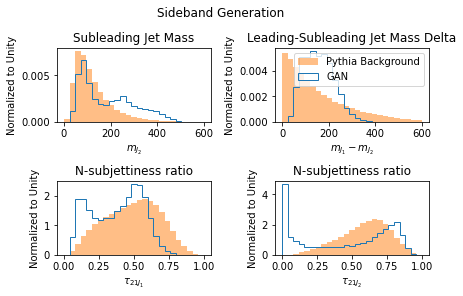

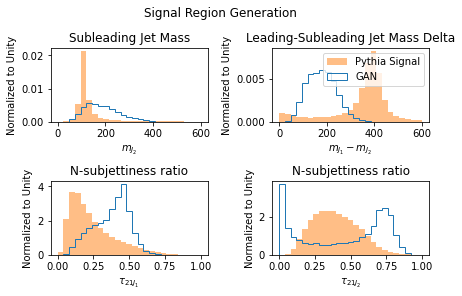

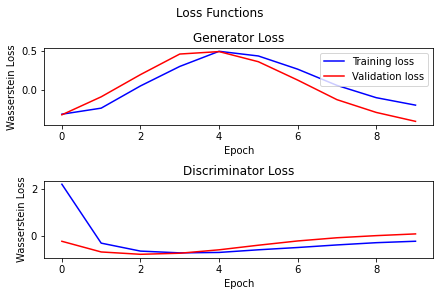

  1%|          | 19/2000 [00:44<1:10:38,  2.14s/it]
Epoch 20:


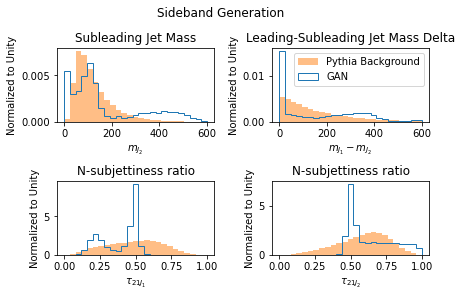

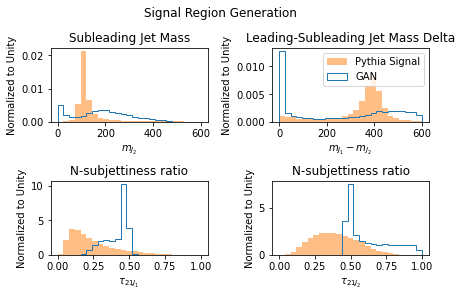

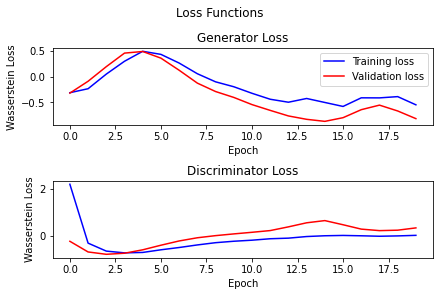

  1%|▏         | 29/2000 [01:07<1:08:10,  2.08s/it]
Epoch 30:


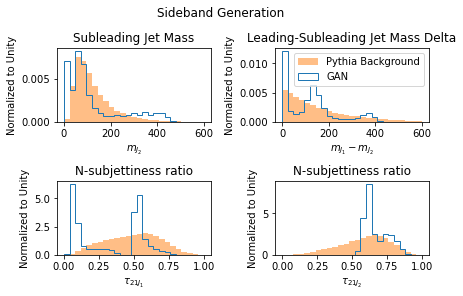

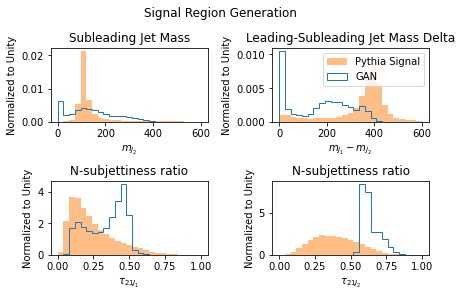

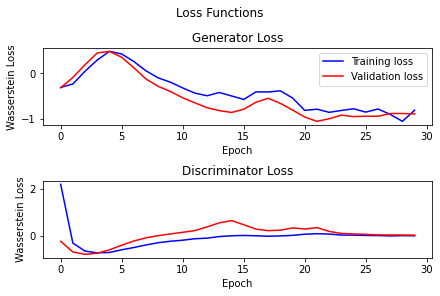

  2%|▏         | 39/2000 [01:30<1:06:47,  2.04s/it]
Epoch 40:


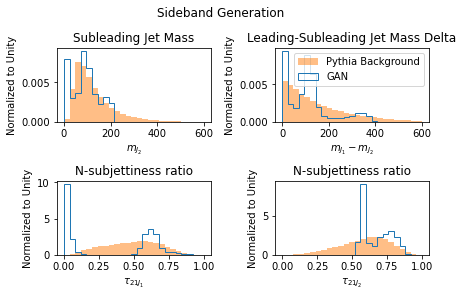

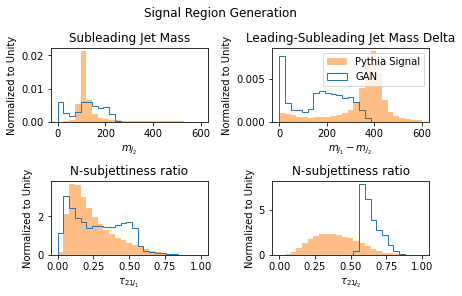

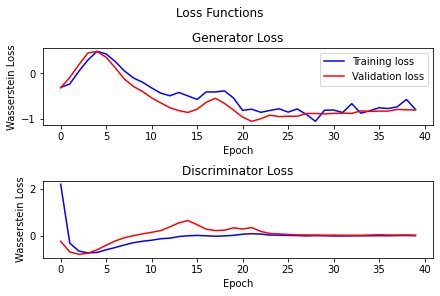

  2%|▏         | 49/2000 [01:53<1:07:21,  2.07s/it]
Epoch 50:


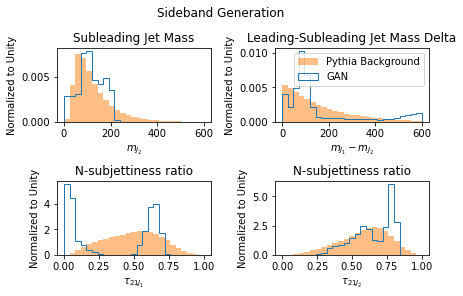

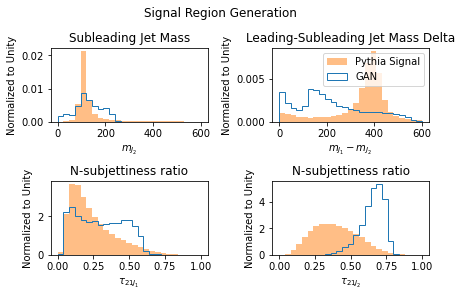

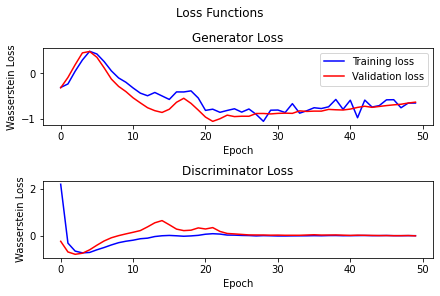

  3%|▎         | 59/2000 [02:16<1:06:51,  2.07s/it]
Epoch 60:


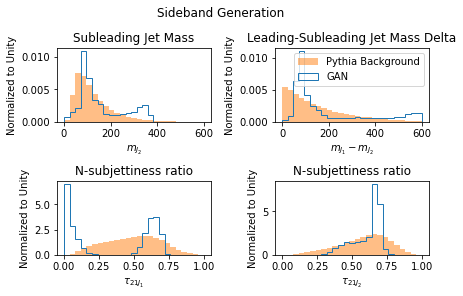

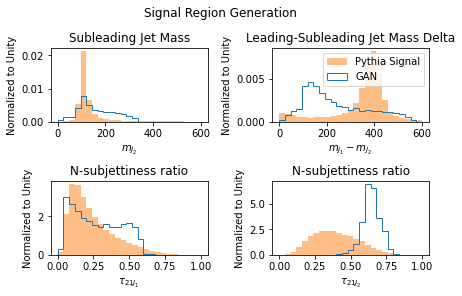

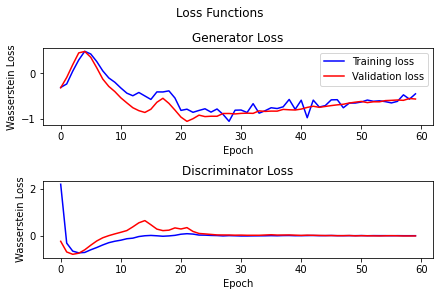

  3%|▎         | 69/2000 [02:40<1:12:52,  2.26s/it]
Epoch 70:


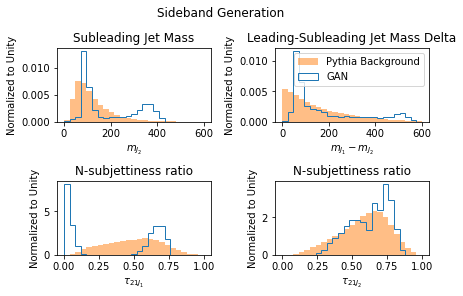

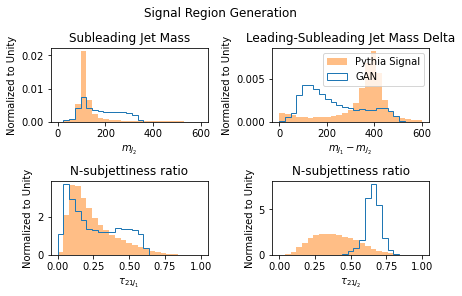

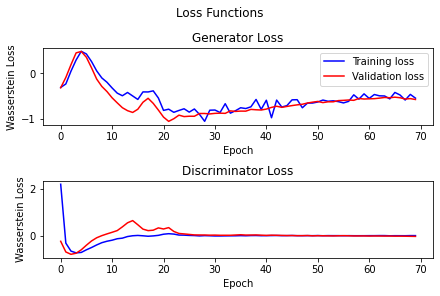

  4%|▍         | 79/2000 [03:06<1:15:05,  2.35s/it]
Epoch 80:


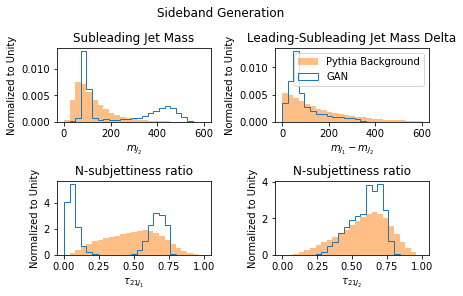

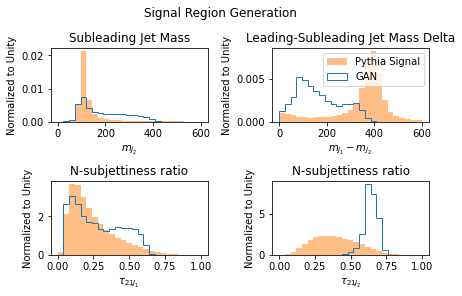

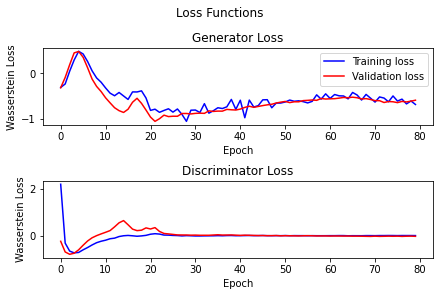

  4%|▍         | 89/2000 [03:33<1:14:41,  2.35s/it]
Epoch 90:


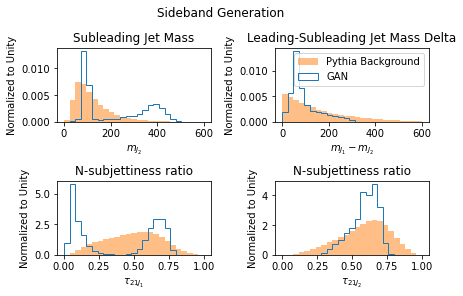

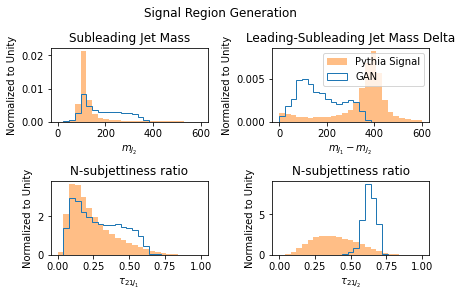

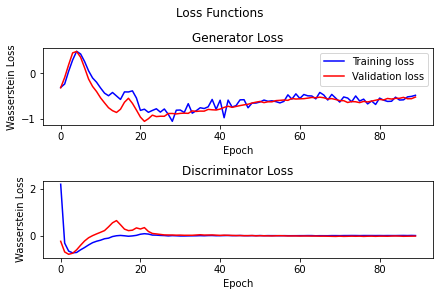

  5%|▍         | 99/2000 [03:59<1:14:33,  2.35s/it]
Epoch 100:


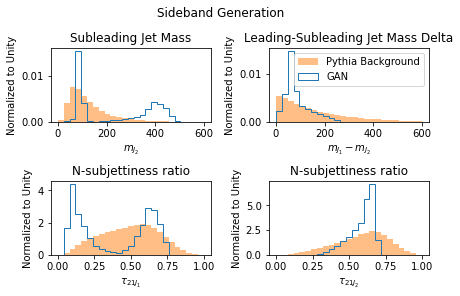

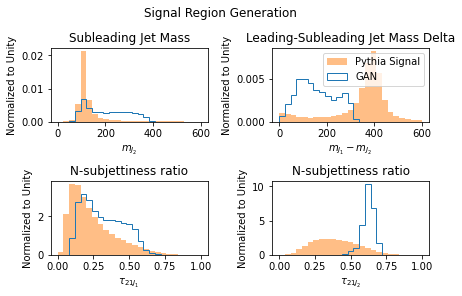

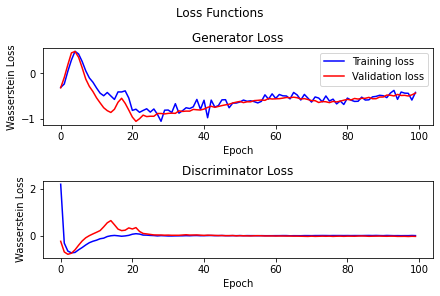

  5%|▌         | 109/2000 [04:25<1:07:17,  2.14s/it]
Epoch 110:


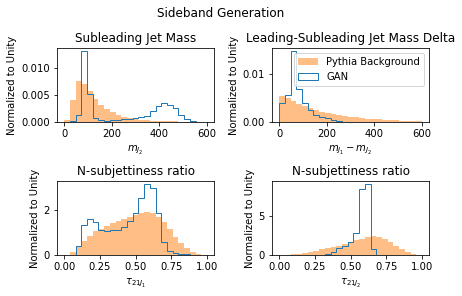

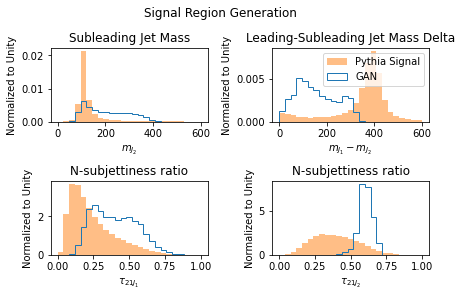

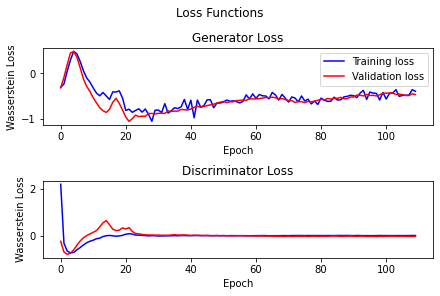

  6%|▌         | 119/2000 [04:48<1:06:50,  2.13s/it]
Epoch 120:


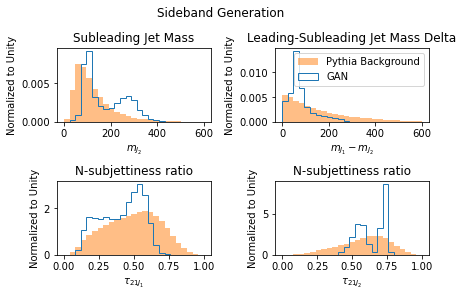

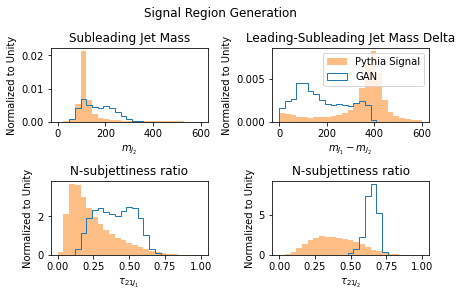

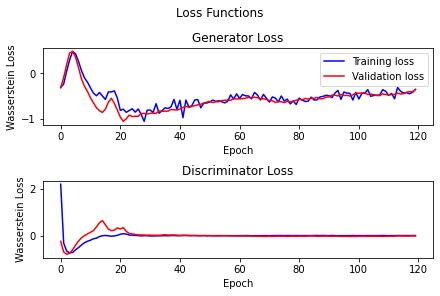

  6%|▋         | 129/2000 [05:12<1:07:01,  2.15s/it]
Epoch 130:


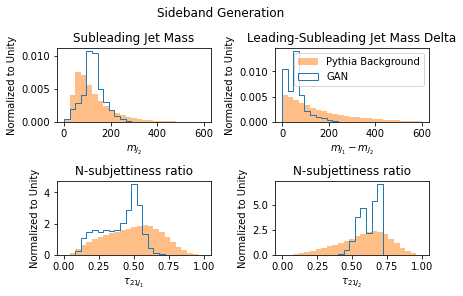

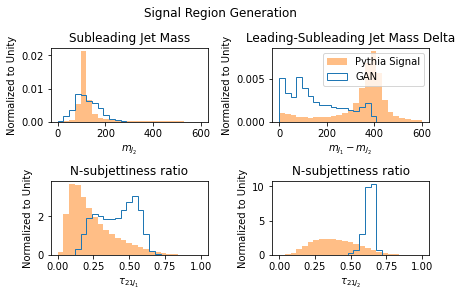

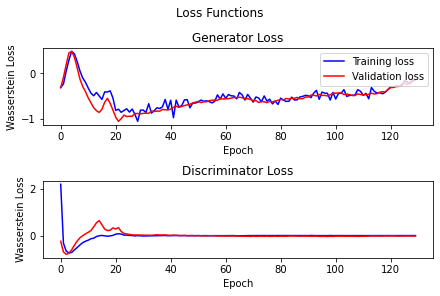

  7%|▋         | 139/2000 [05:36<1:05:42,  2.12s/it]
Epoch 140:


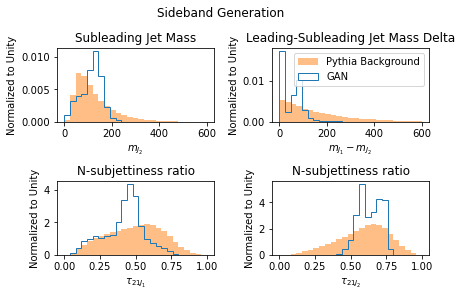

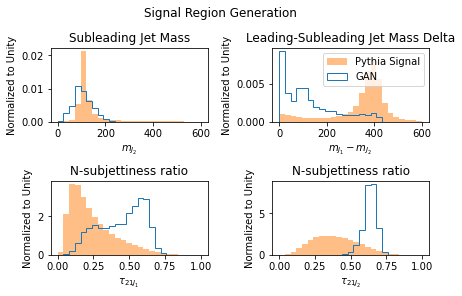

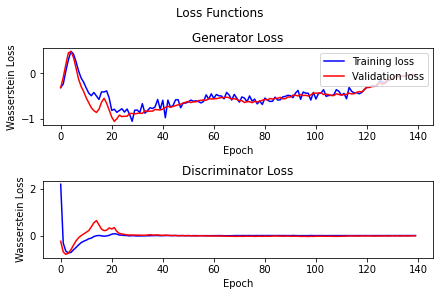

  7%|▋         | 149/2000 [05:59<1:04:27,  2.09s/it]
Epoch 150:


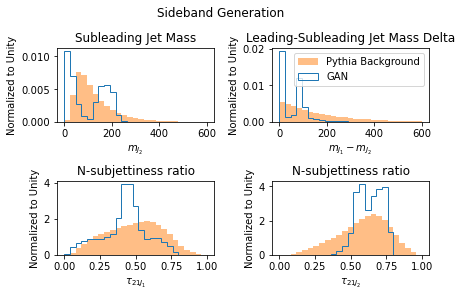

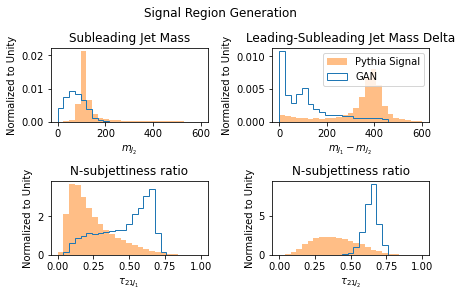

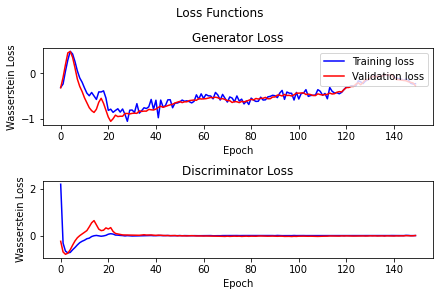

  8%|▊         | 159/2000 [06:23<1:04:09,  2.09s/it]
Epoch 160:


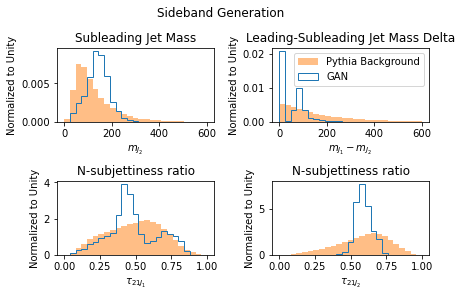

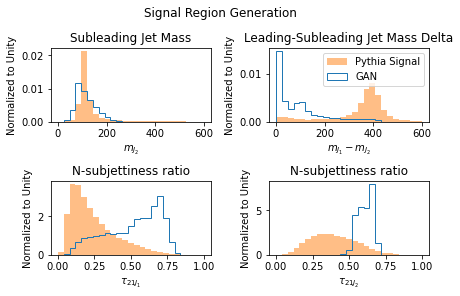

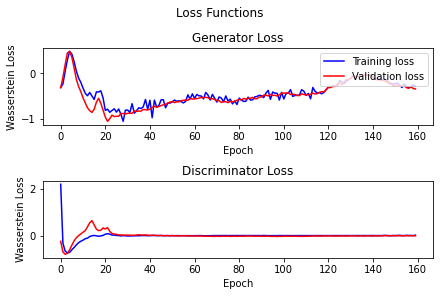

  8%|▊         | 169/2000 [06:46<1:03:36,  2.08s/it]
Epoch 170:


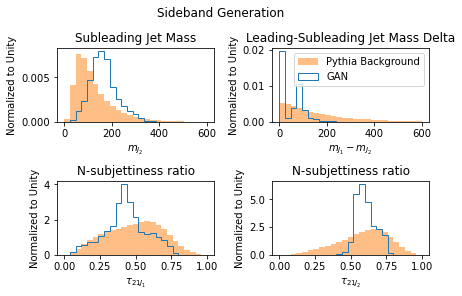

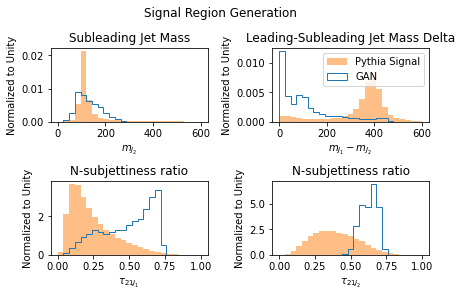

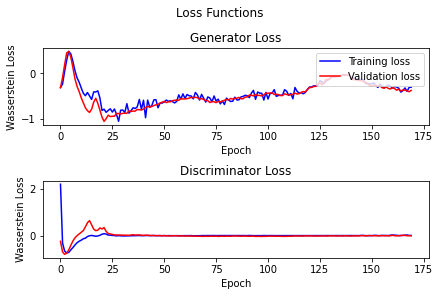

  9%|▉         | 179/2000 [07:10<1:03:58,  2.11s/it]
Epoch 180:


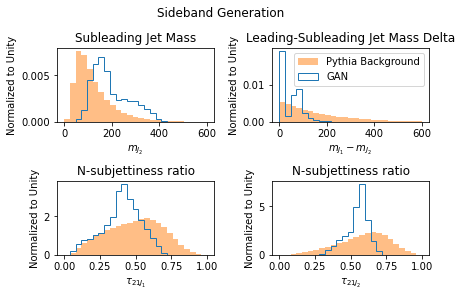

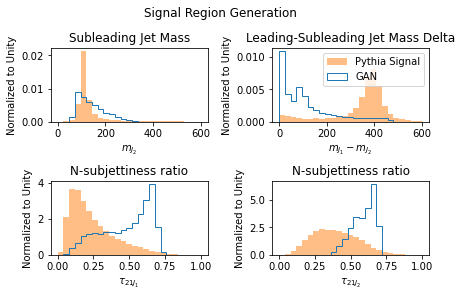

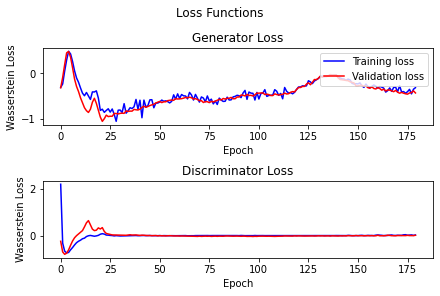

  9%|▉         | 189/2000 [07:34<1:03:30,  2.10s/it]
Epoch 190:


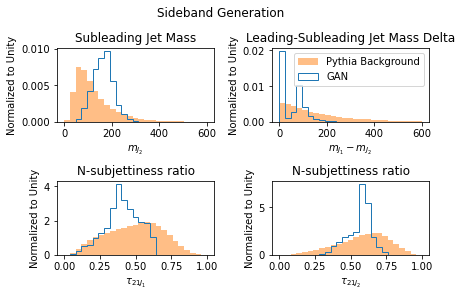

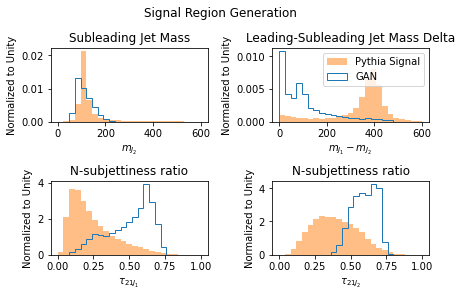

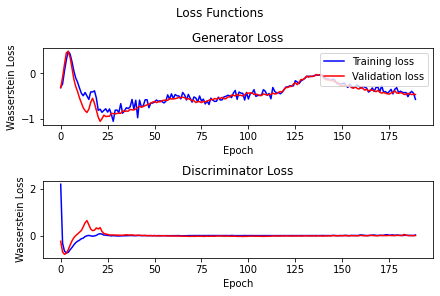

 10%|▉         | 199/2000 [07:57<1:03:47,  2.12s/it]
Epoch 200:


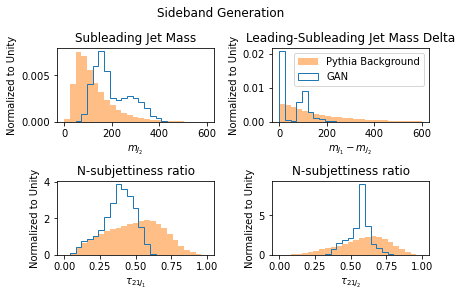

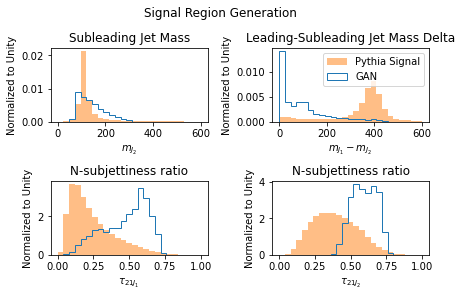

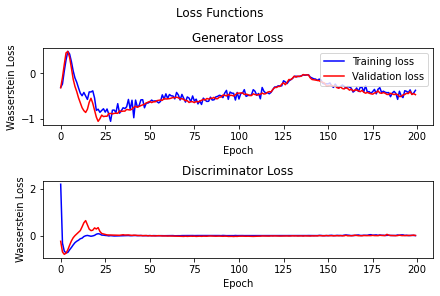

 10%|█         | 209/2000 [08:23<1:06:09,  2.22s/it]
Epoch 210:


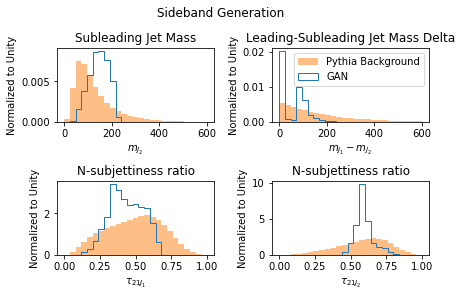

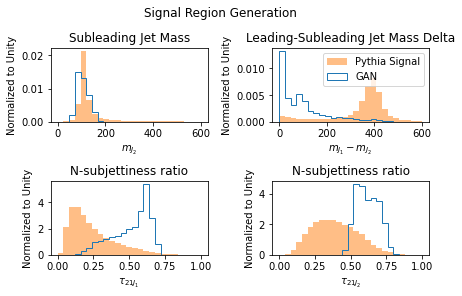

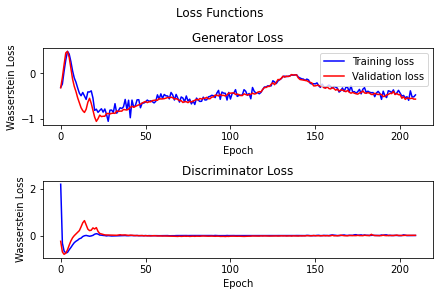

 11%|█         | 219/2000 [08:49<1:04:37,  2.18s/it]
Epoch 220:


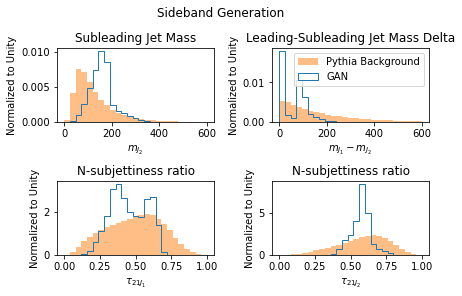

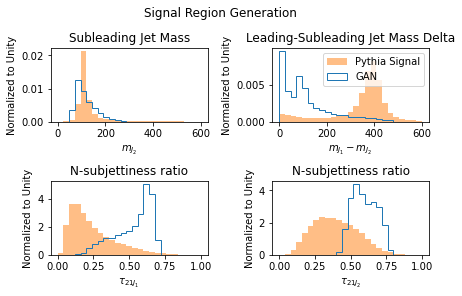

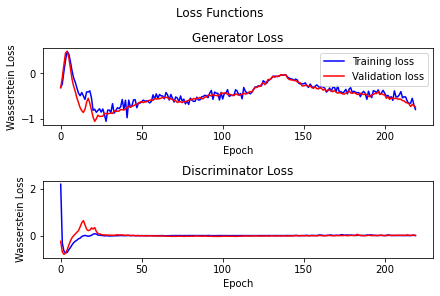

 11%|█▏        | 229/2000 [09:14<1:03:45,  2.16s/it]
Epoch 230:


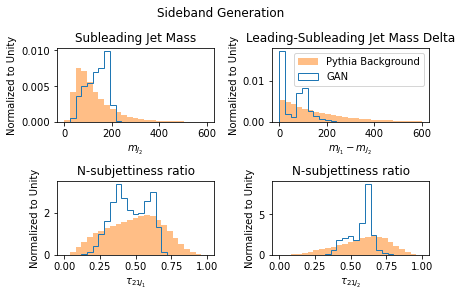

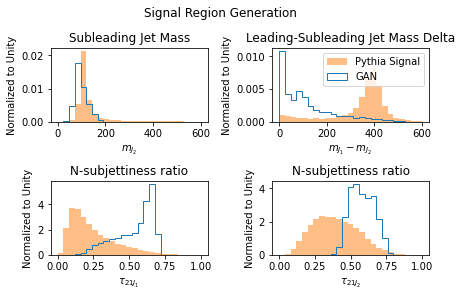

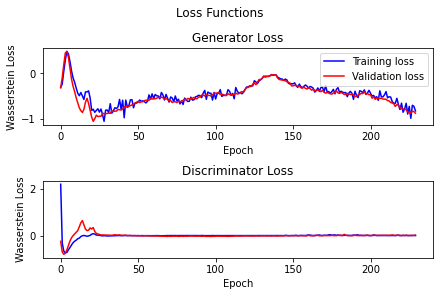

 12%|█▏        | 239/2000 [09:38<1:02:37,  2.13s/it]
Epoch 240:


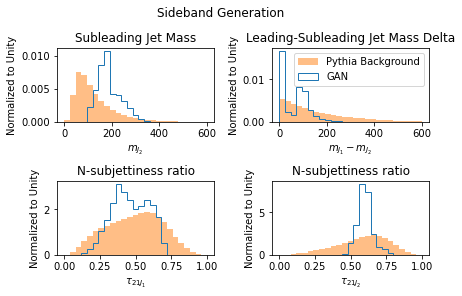

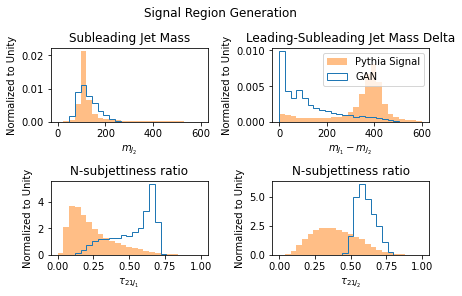

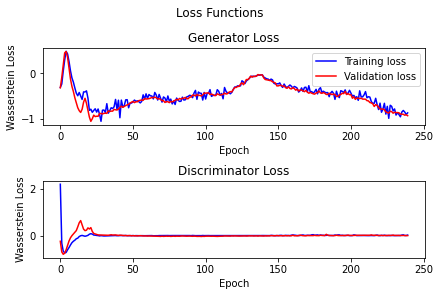

 12%|█▏        | 249/2000 [10:02<1:01:58,  2.12s/it]
Epoch 250:


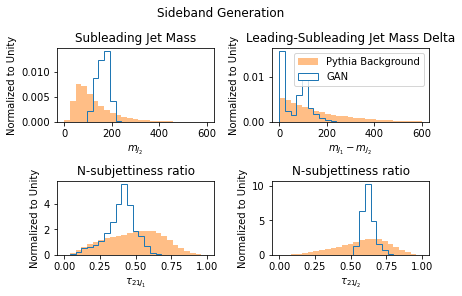

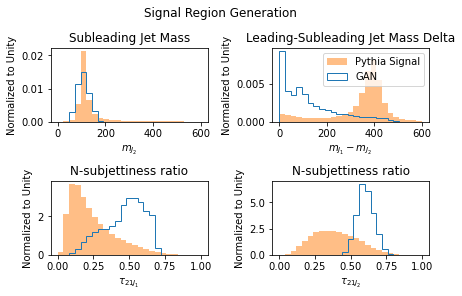

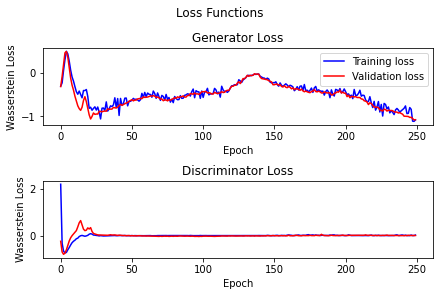

 13%|█▎        | 259/2000 [10:25<1:00:55,  2.10s/it]
Epoch 260:


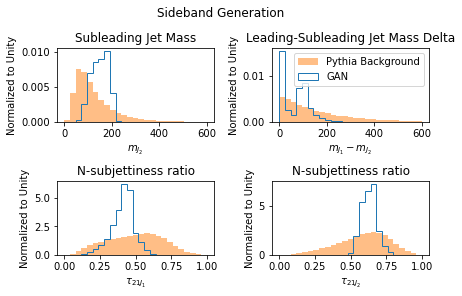

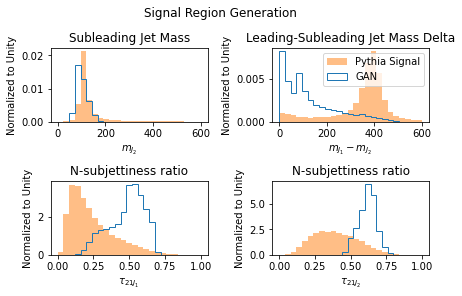

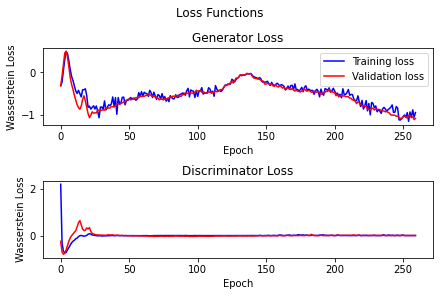

 13%|█▎        | 269/2000 [10:49<1:00:58,  2.11s/it]
Epoch 270:


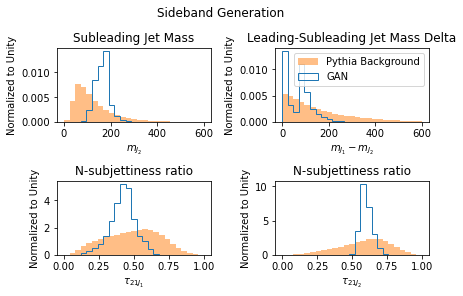

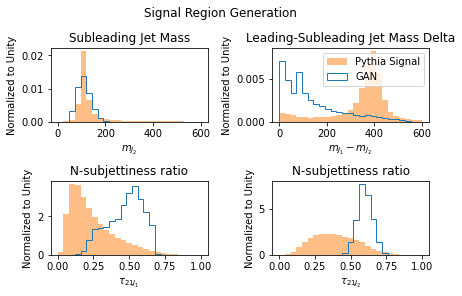

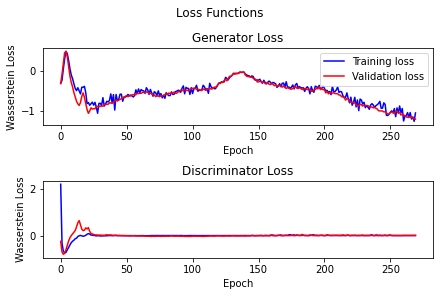

 14%|█▍        | 279/2000 [11:13<1:00:23,  2.11s/it]
Epoch 280:


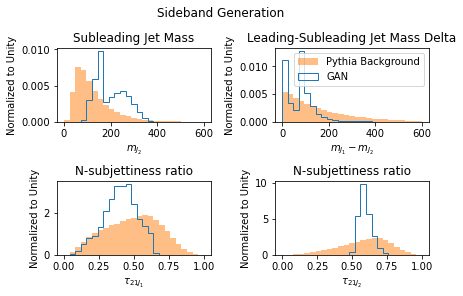

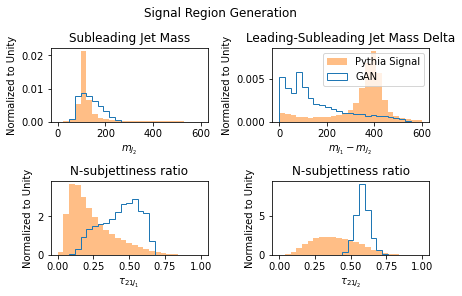

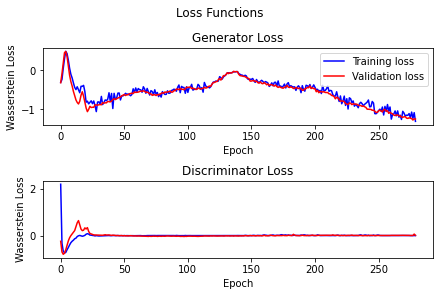

 14%|█▍        | 289/2000 [11:37<1:00:29,  2.12s/it]
Epoch 290:


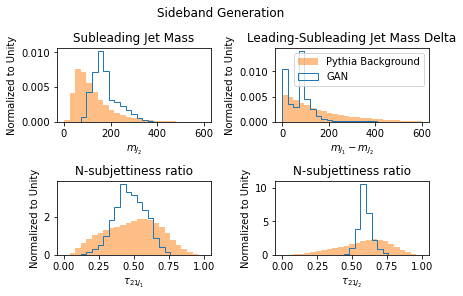

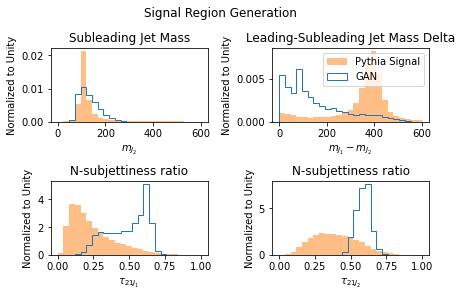

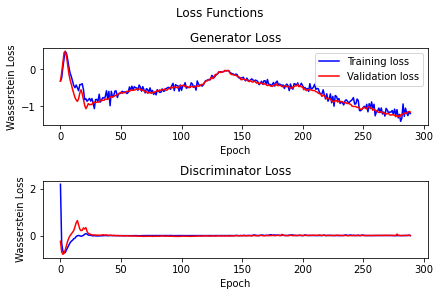

 15%|█▍        | 299/2000 [12:01<1:00:20,  2.13s/it]
Epoch 300:


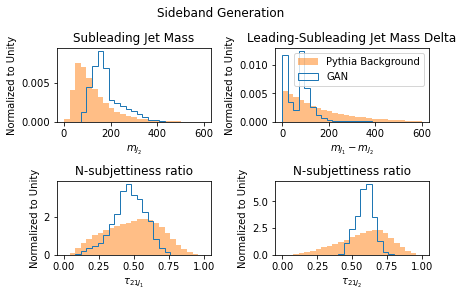

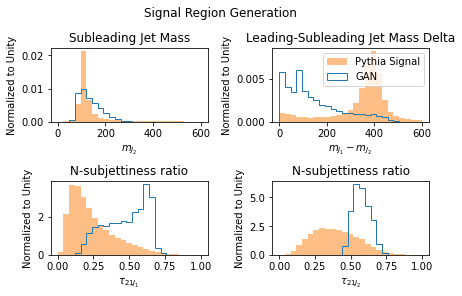

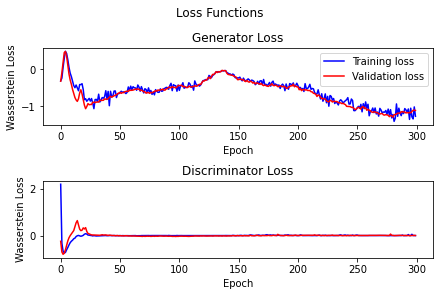

 15%|█▌        | 309/2000 [12:25<1:00:10,  2.14s/it]
Epoch 310:


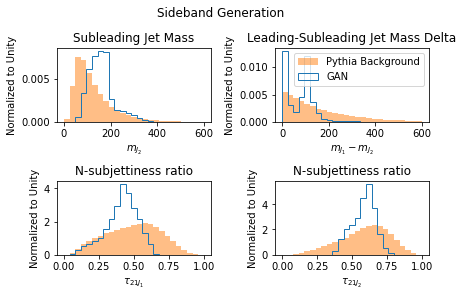

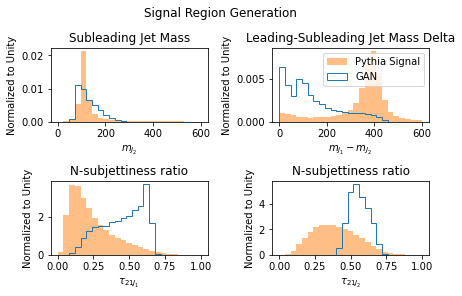

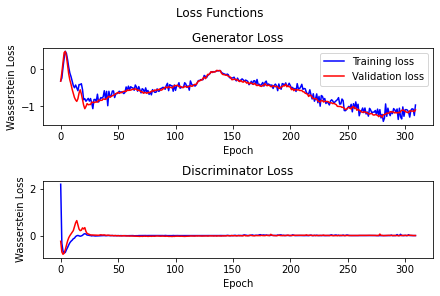

 16%|█▌        | 319/2000 [12:49<59:39,  2.13s/it]  
Epoch 320:


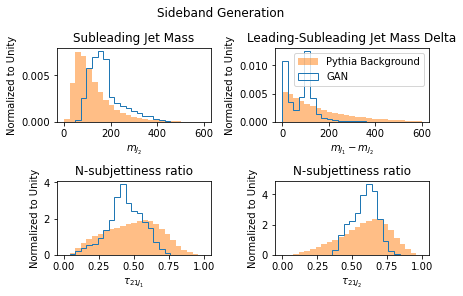

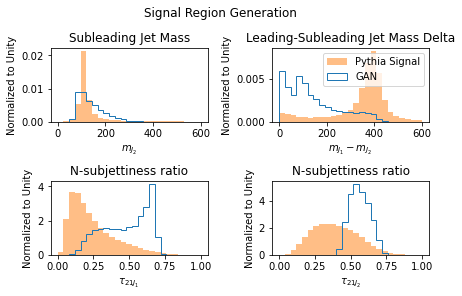

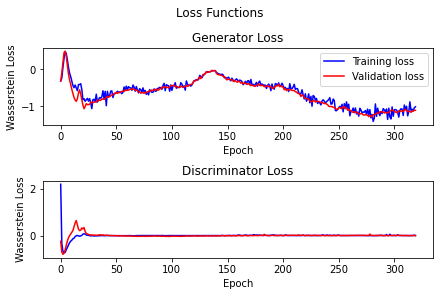

 16%|█▋        | 329/2000 [13:13<59:39,  2.14s/it]  
Epoch 330:


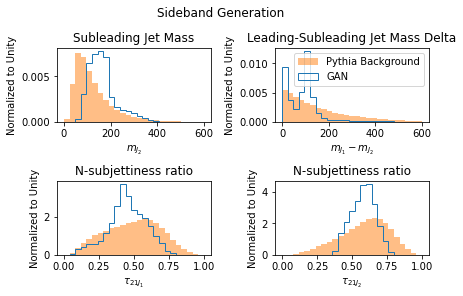

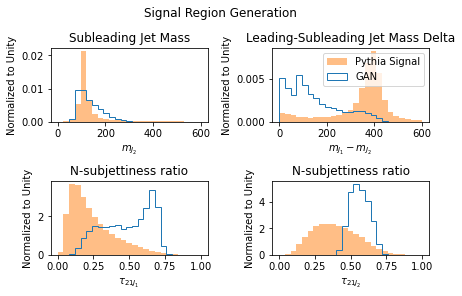

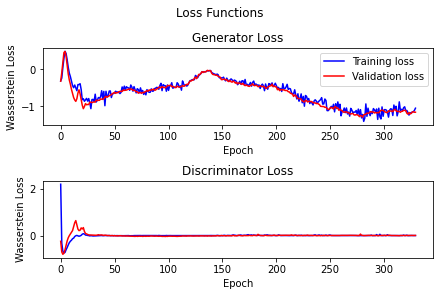

 17%|█▋        | 339/2000 [13:37<58:31,  2.11s/it]
Epoch 340:


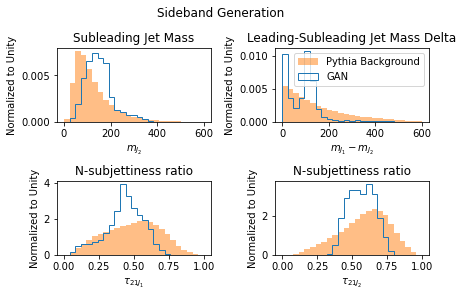

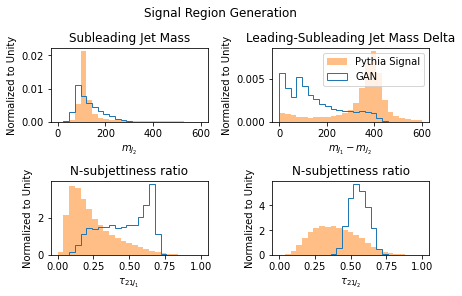

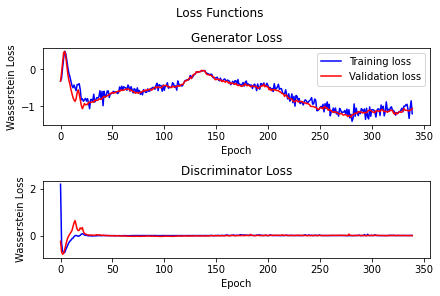

 17%|█▋        | 349/2000 [14:01<58:28,  2.13s/it]
Epoch 350:


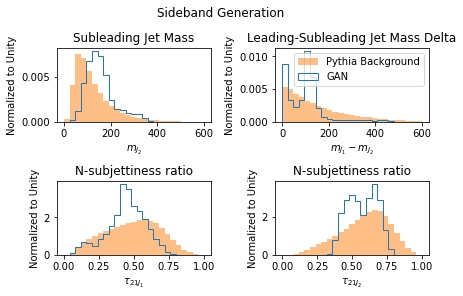

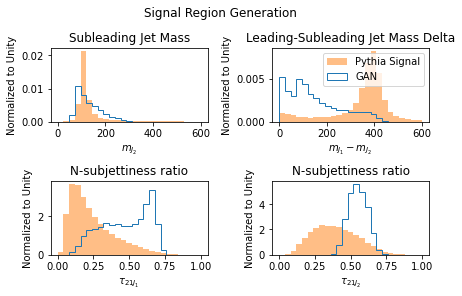

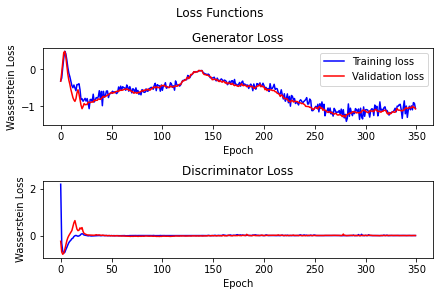

 18%|█▊        | 359/2000 [14:25<58:28,  2.14s/it]
Epoch 360:


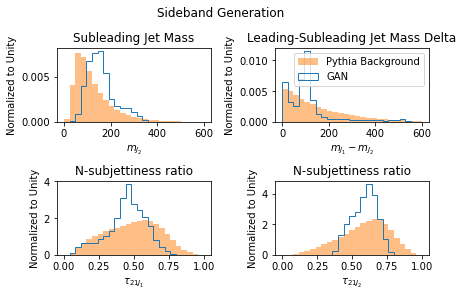

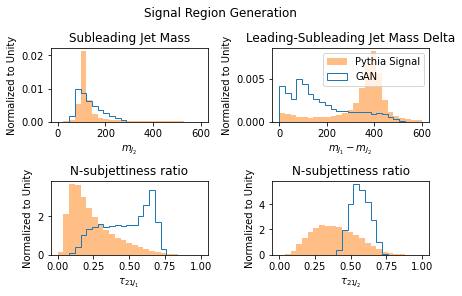

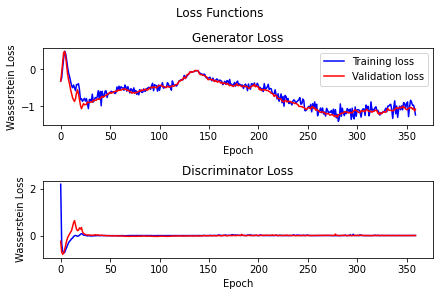

 18%|█▊        | 369/2000 [14:49<57:16,  2.11s/it]
Epoch 370:


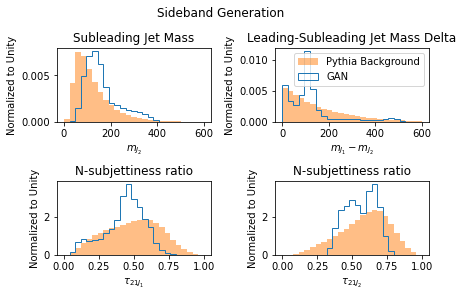

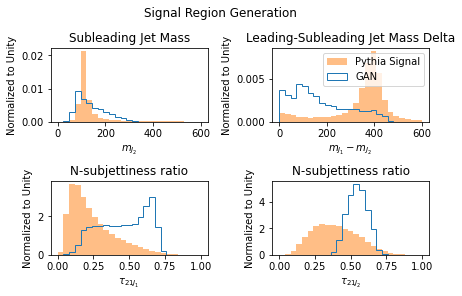

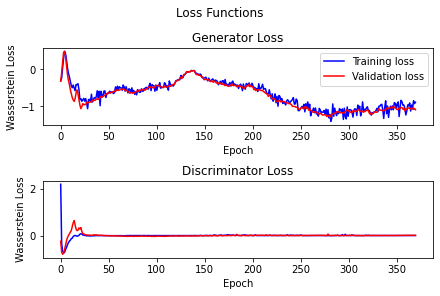

 19%|█▉        | 379/2000 [15:13<58:29,  2.17s/it]
Epoch 380:


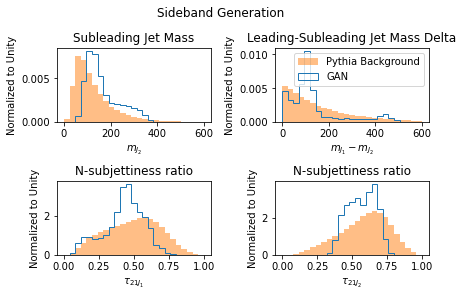

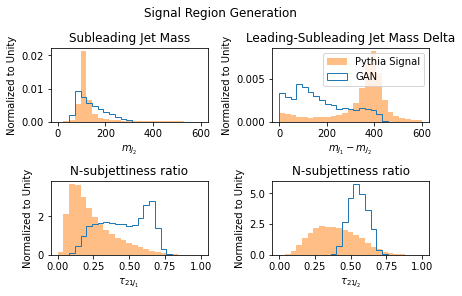

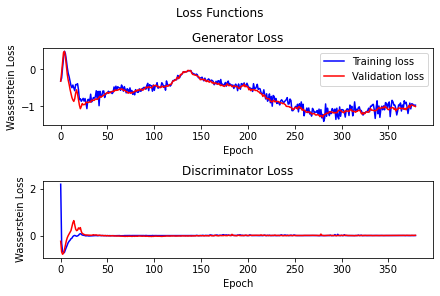

 19%|█▉        | 389/2000 [15:37<57:43,  2.15s/it]
Epoch 390:


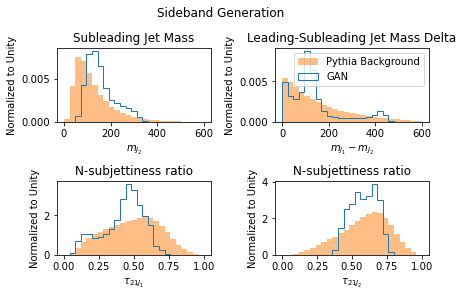

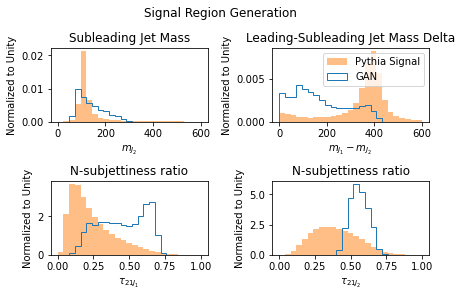

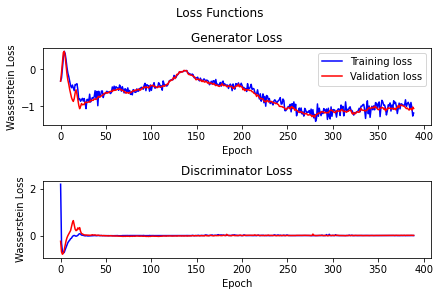

 20%|█▉        | 399/2000 [16:02<57:18,  2.15s/it]
Epoch 400:


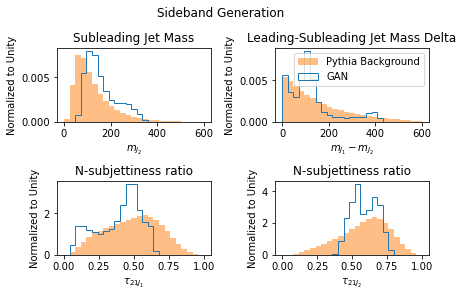

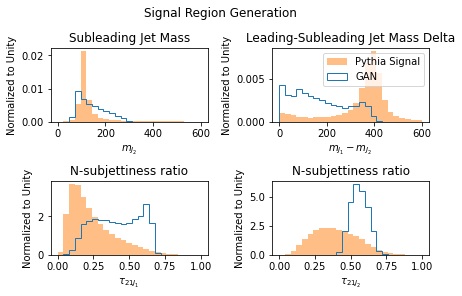

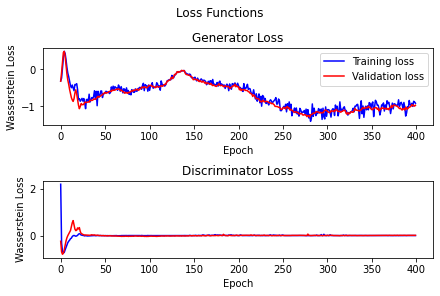

 20%|██        | 409/2000 [16:26<57:25,  2.17s/it]
Epoch 410:


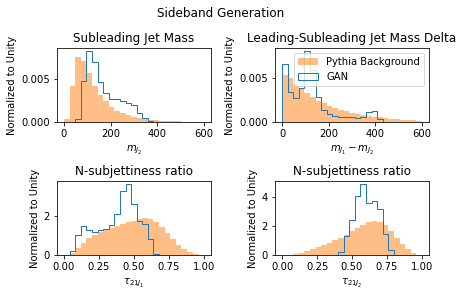

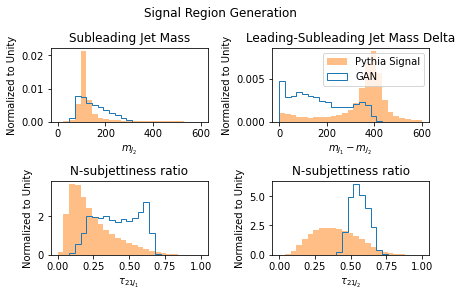

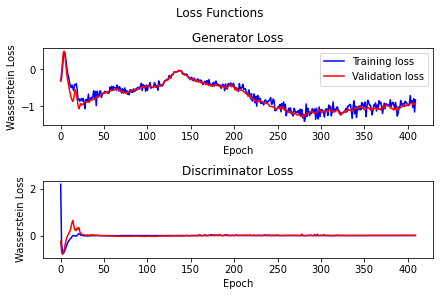

 21%|██        | 419/2000 [16:50<56:00,  2.13s/it]
Epoch 420:


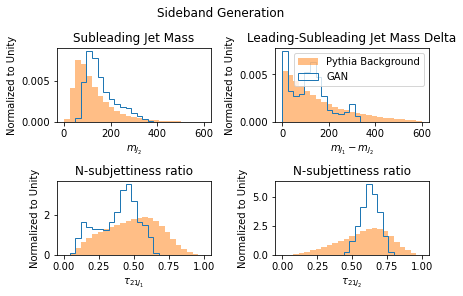

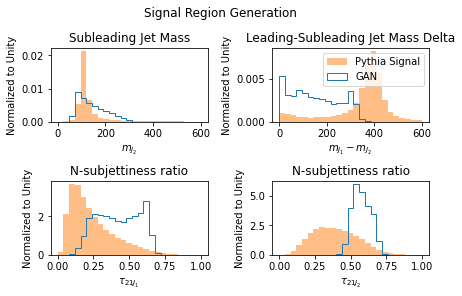

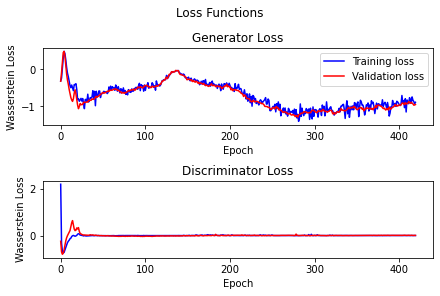

 21%|██▏       | 429/2000 [17:14<56:03,  2.14s/it]
Epoch 430:


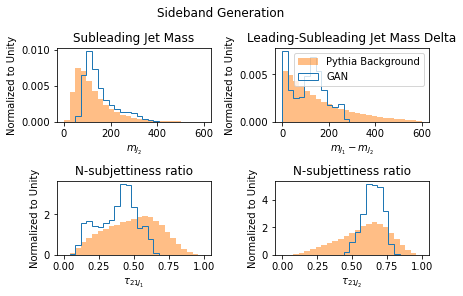

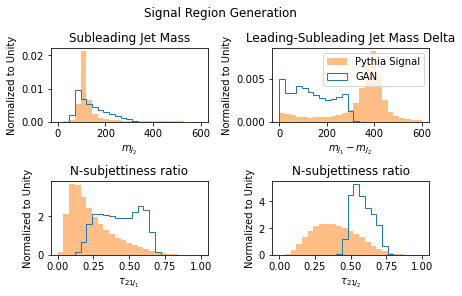

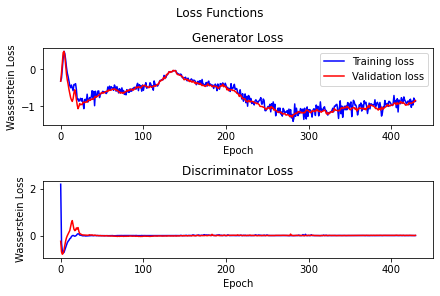

 22%|██▏       | 439/2000 [17:39<56:24,  2.17s/it]
Epoch 440:


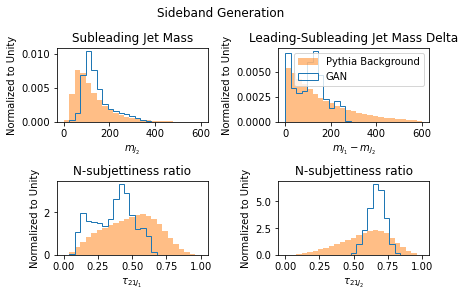

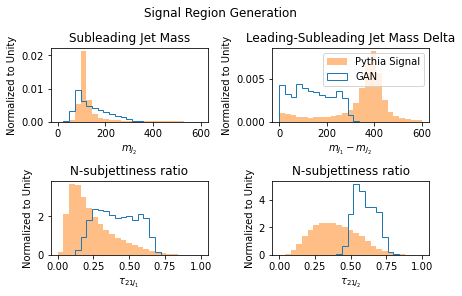

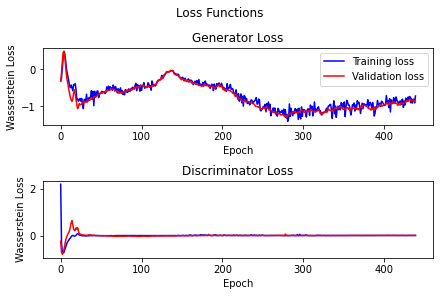

 22%|██▏       | 449/2000 [18:05<59:42,  2.31s/it]  
Epoch 450:


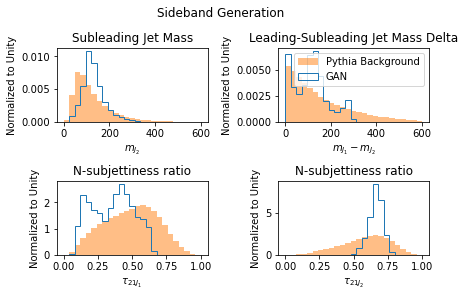

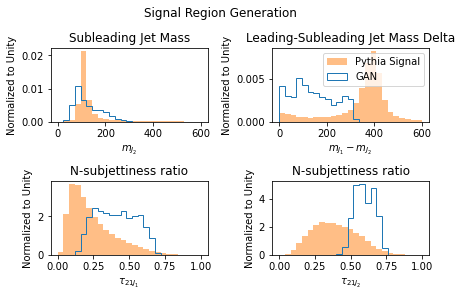

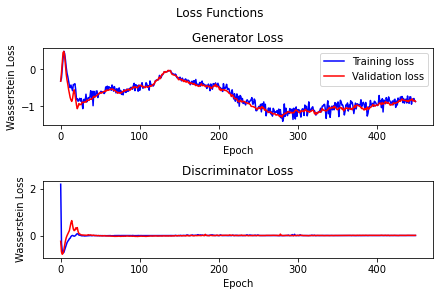

 23%|██▎       | 459/2000 [18:32<59:44,  2.33s/it]  
Epoch 460:


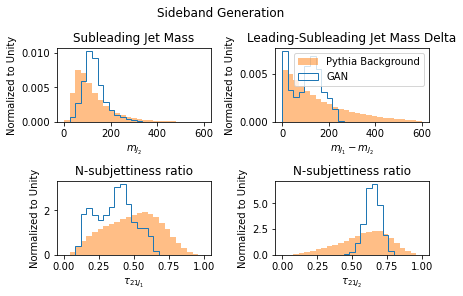

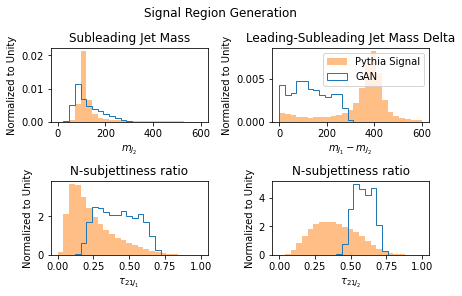

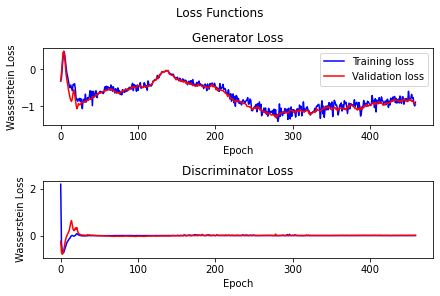

 23%|██▎       | 469/2000 [18:58<58:24,  2.29s/it]
Epoch 470:


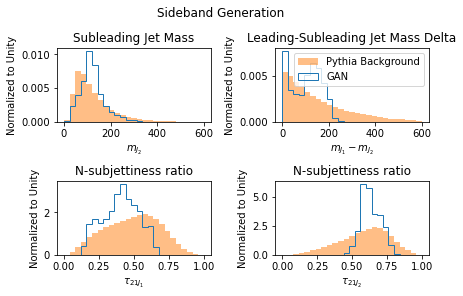

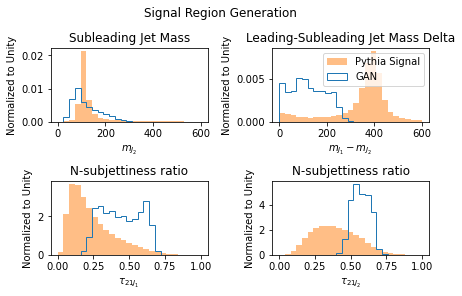

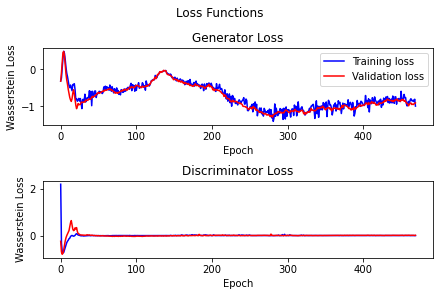

 24%|██▍       | 479/2000 [19:24<59:00,  2.33s/it]
Epoch 480:


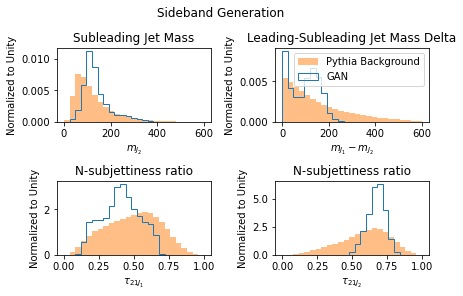

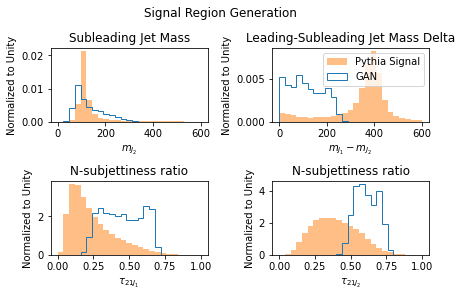

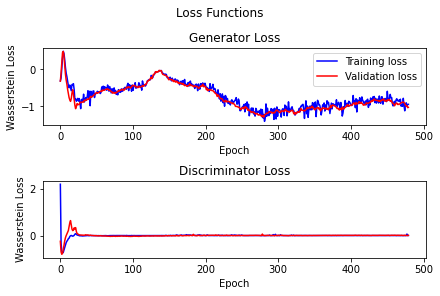

 24%|██▍       | 489/2000 [19:51<58:56,  2.34s/it]
Epoch 490:


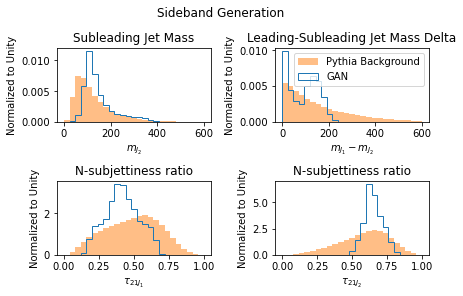

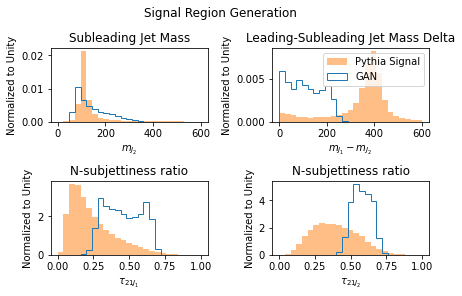

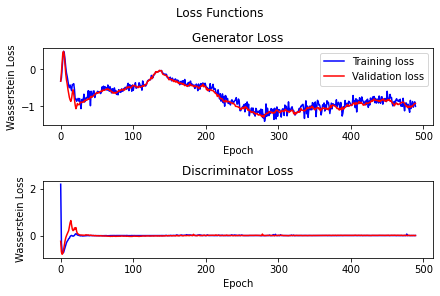

 25%|██▍       | 499/2000 [20:18<58:44,  2.35s/it]
Epoch 500:


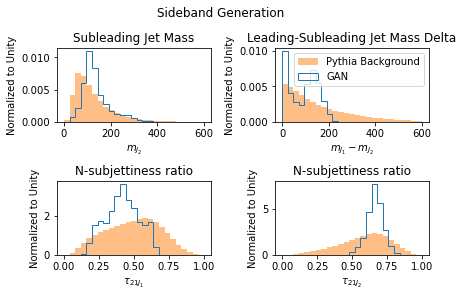

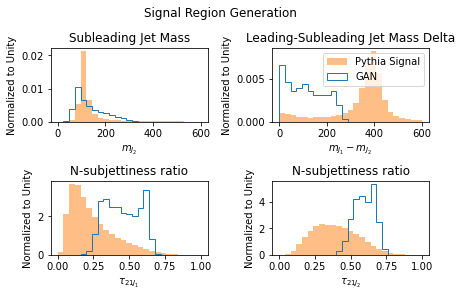

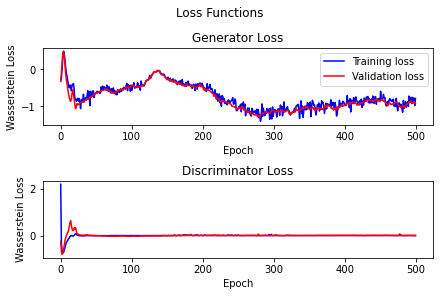

 25%|██▌       | 509/2000 [20:45<59:07,  2.38s/it]
Epoch 510:


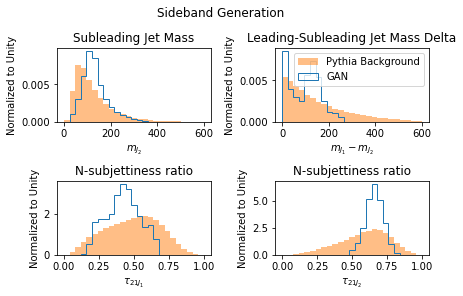

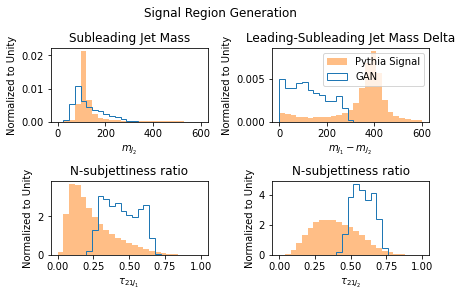

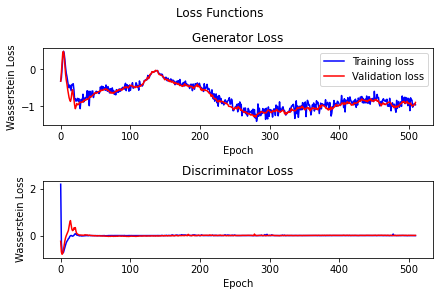

 26%|██▌       | 519/2000 [21:12<58:41,  2.38s/it]
Epoch 520:


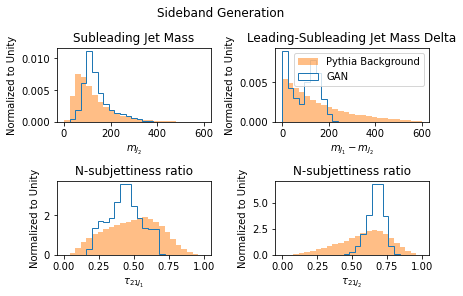

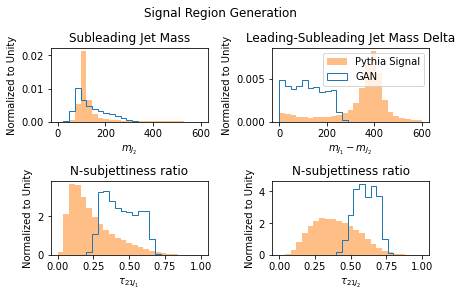

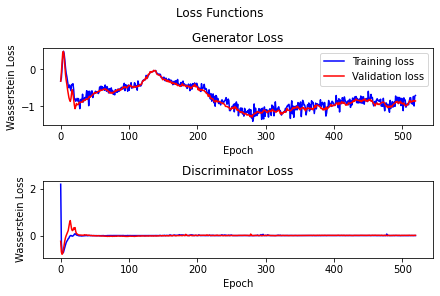

 26%|██▋       | 529/2000 [21:39<59:43,  2.44s/it]  
Epoch 530:


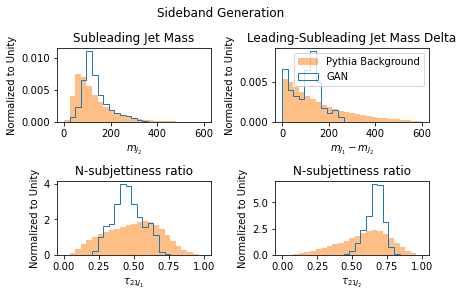

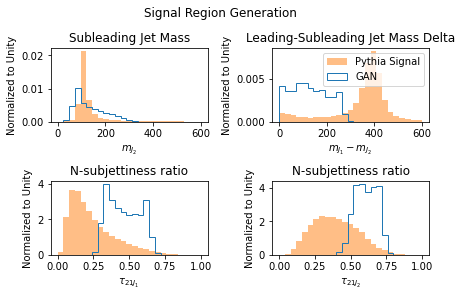

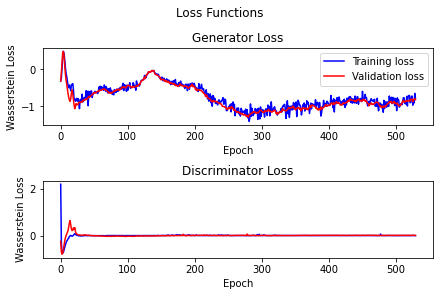

 27%|██▋       | 539/2000 [22:06<58:31,  2.40s/it]
Epoch 540:


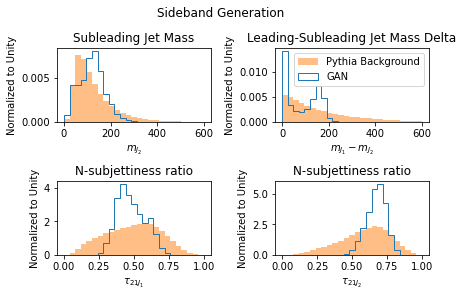

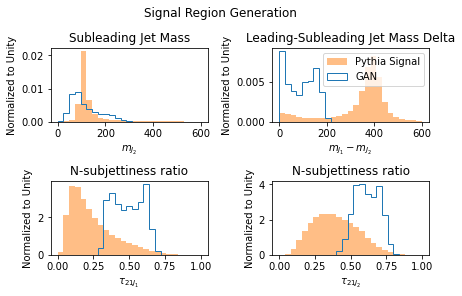

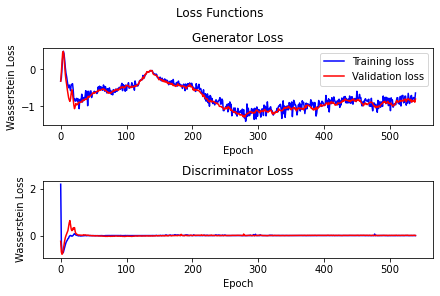

 27%|██▋       | 549/2000 [22:34<58:14,  2.41s/it]
Epoch 550:


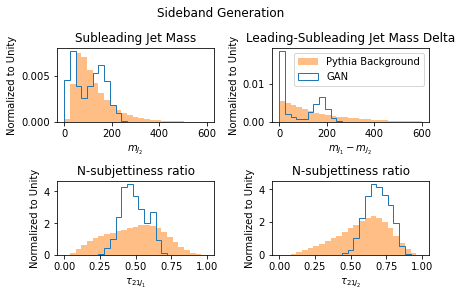

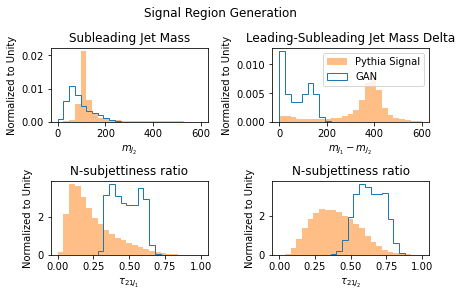

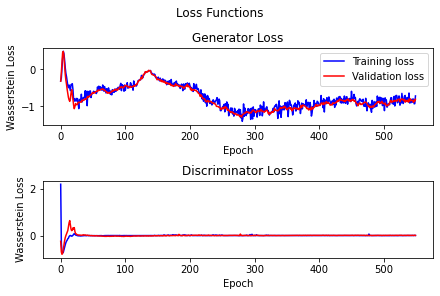

 28%|██▊       | 559/2000 [23:02<57:47,  2.41s/it]
Epoch 560:


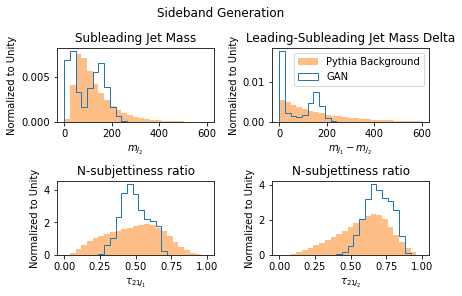

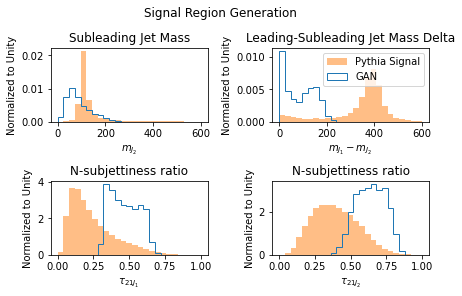

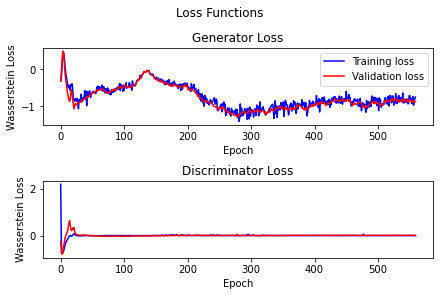

 28%|██▊       | 569/2000 [23:31<1:03:27,  2.66s/it]
Epoch 570:


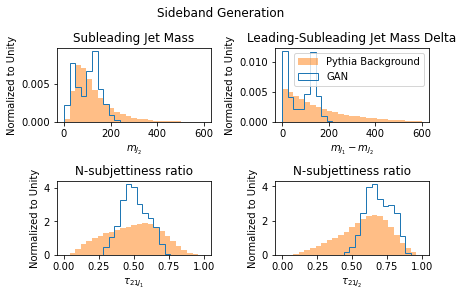

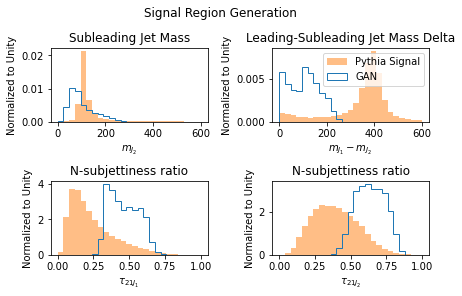

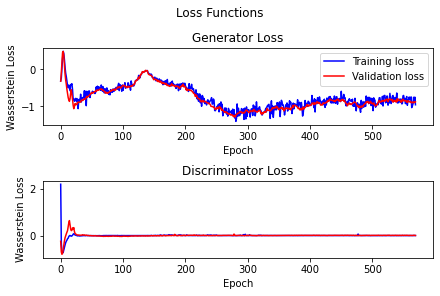

 29%|██▉       | 579/2000 [24:00<57:23,  2.42s/it]
Epoch 580:


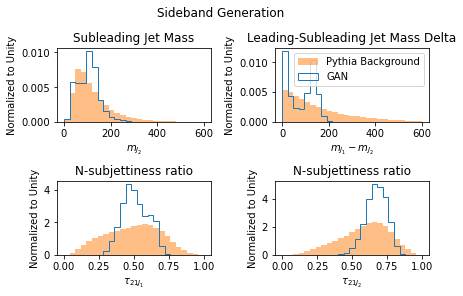

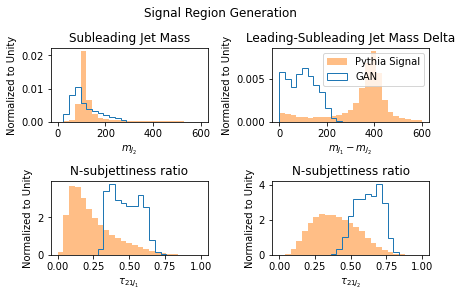

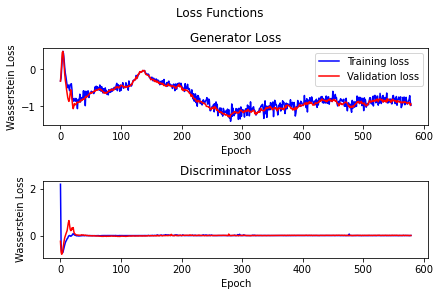

 29%|██▉       | 589/2000 [24:27<56:29,  2.40s/it]
Epoch 590:


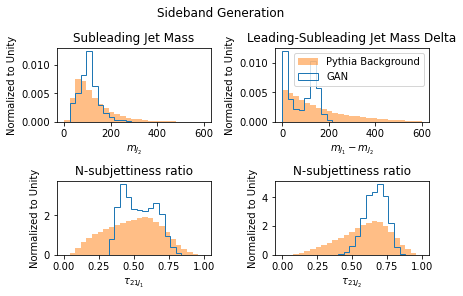

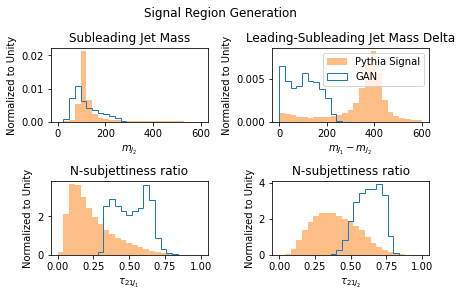

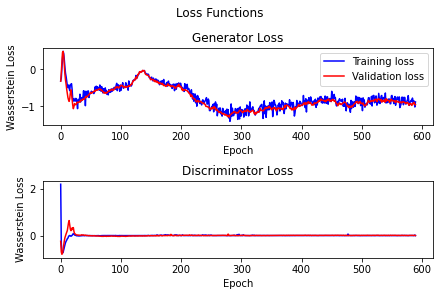

 30%|██▉       | 599/2000 [24:56<56:52,  2.44s/it]
Epoch 600:


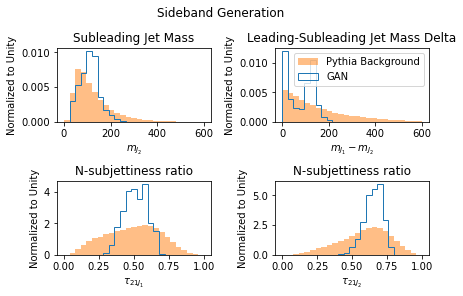

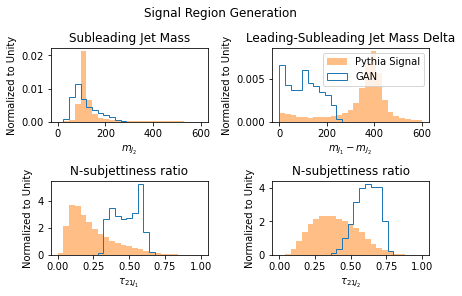

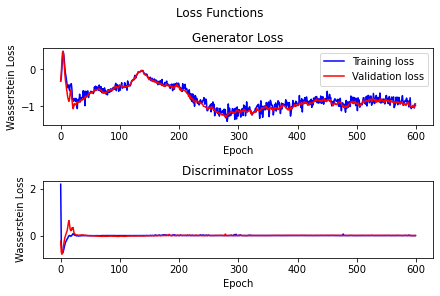

 30%|███       | 609/2000 [25:24<56:09,  2.42s/it]
Epoch 610:


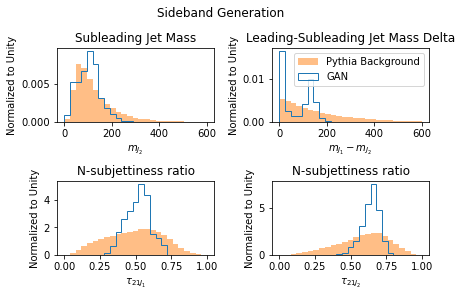

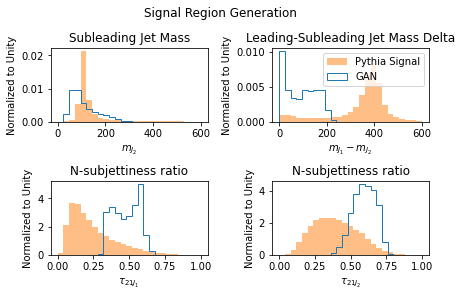

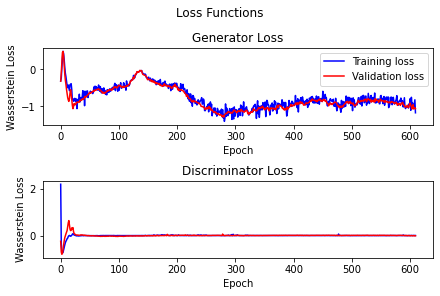

 31%|███       | 619/2000 [25:52<56:04,  2.44s/it]
Epoch 620:


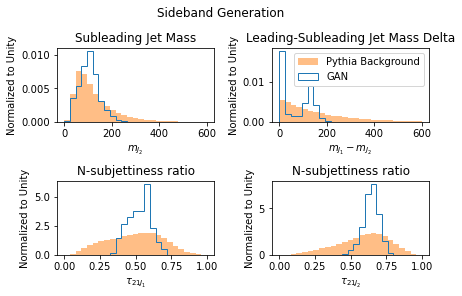

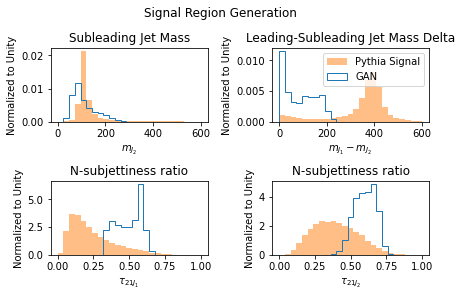

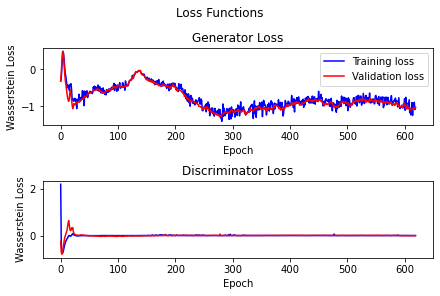

 31%|███▏      | 629/2000 [26:21<56:56,  2.49s/it]
Epoch 630:


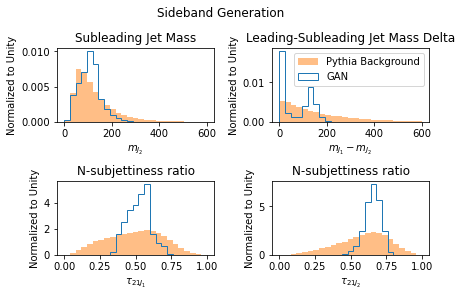

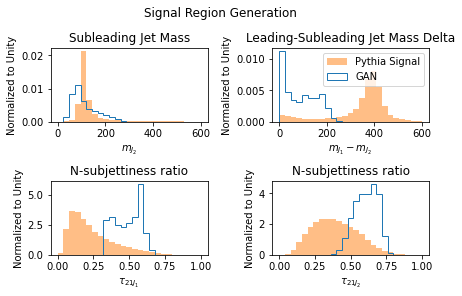

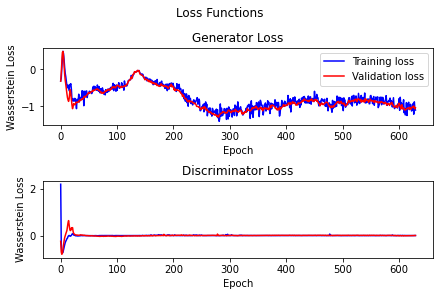

 32%|███▏      | 639/2000 [26:49<56:08,  2.47s/it]
Epoch 640:


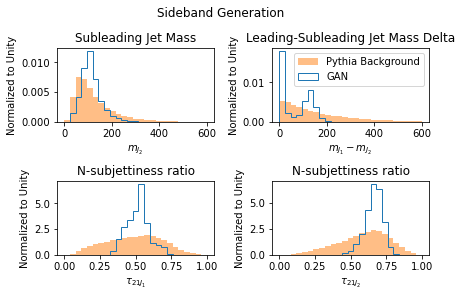

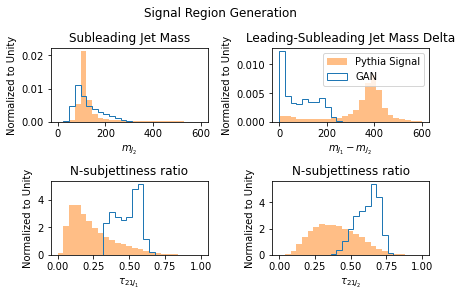

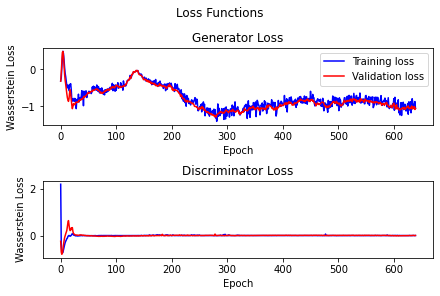

 32%|███▏      | 649/2000 [27:18<55:52,  2.48s/it]
Epoch 650:


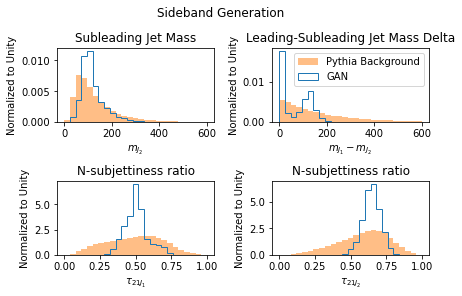

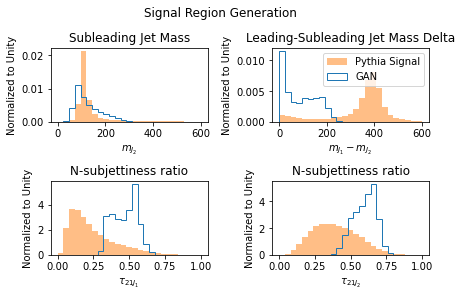

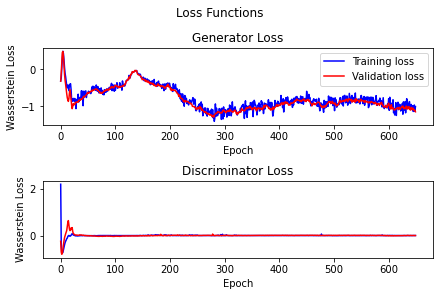

 33%|███▎      | 659/2000 [27:47<56:34,  2.53s/it]
Epoch 660:


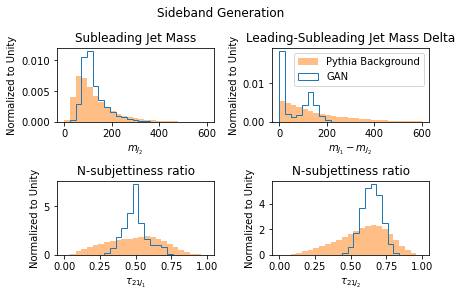

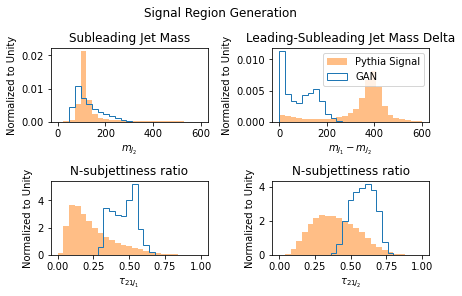

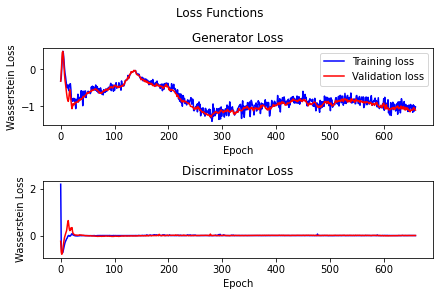

 33%|███▎      | 669/2000 [28:16<55:49,  2.52s/it]
Epoch 670:


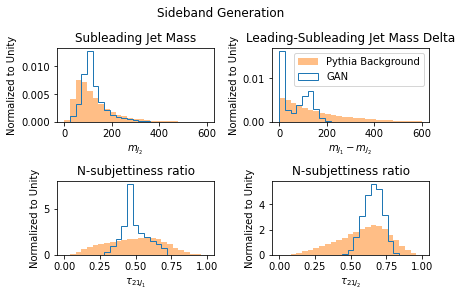

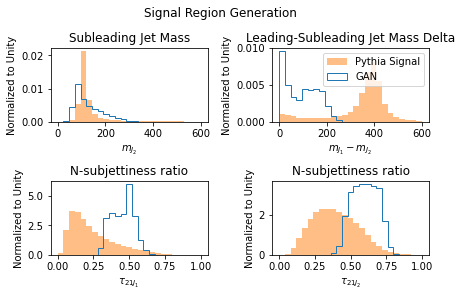

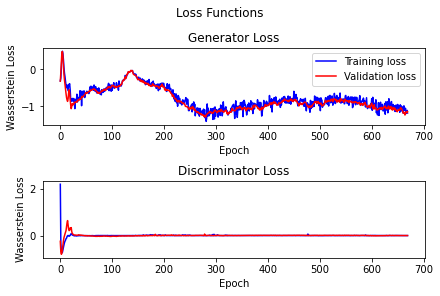

 34%|███▍      | 679/2000 [28:45<55:40,  2.53s/it]
Epoch 680:


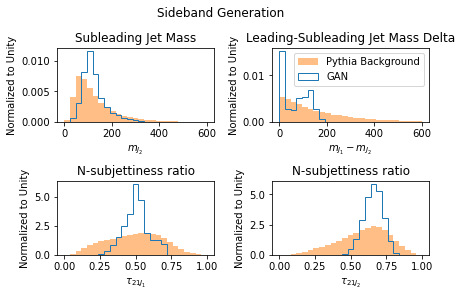

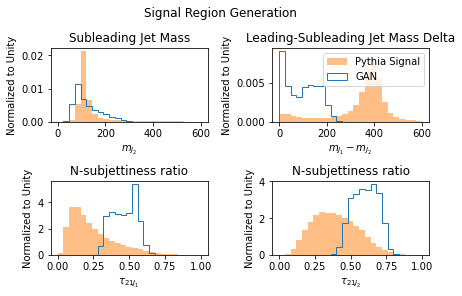

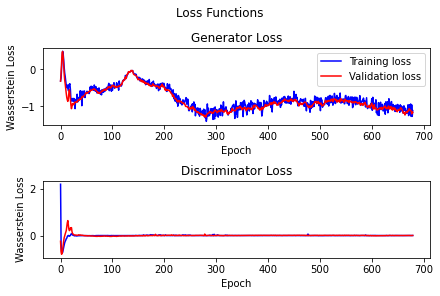

 34%|███▍      | 689/2000 [29:14<55:17,  2.53s/it]
Epoch 690:


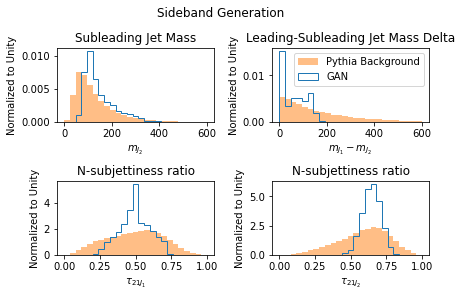

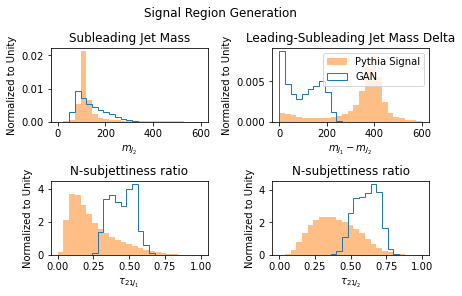

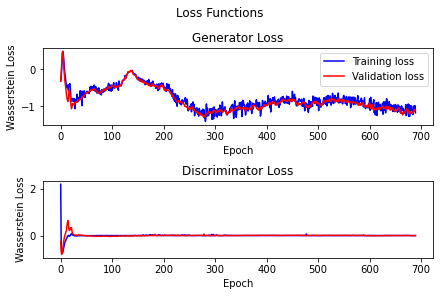

 35%|███▍      | 699/2000 [29:43<54:58,  2.54s/it]
Epoch 700:


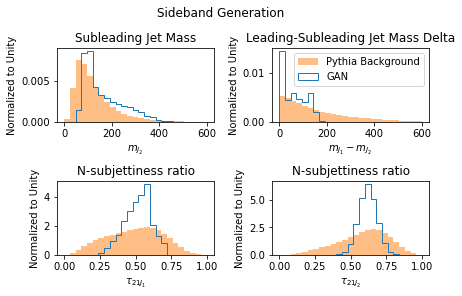

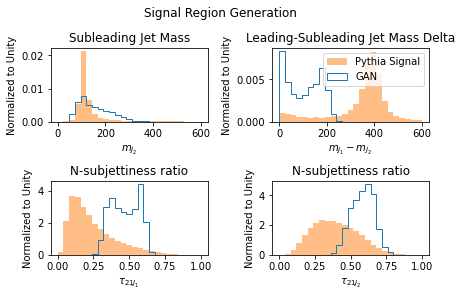

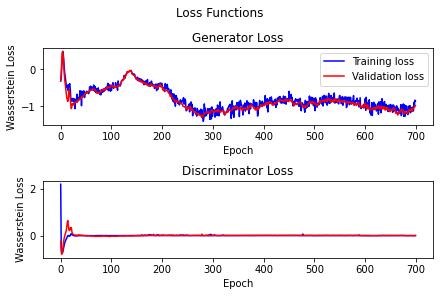

 35%|███▌      | 709/2000 [30:13<55:16,  2.57s/it]
Epoch 710:


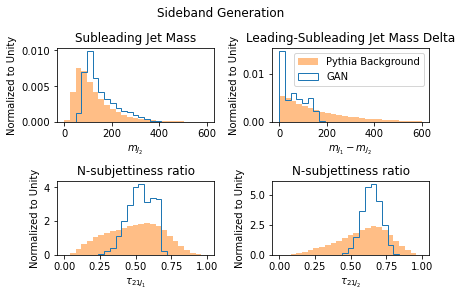

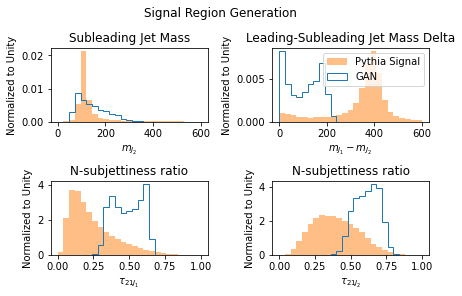

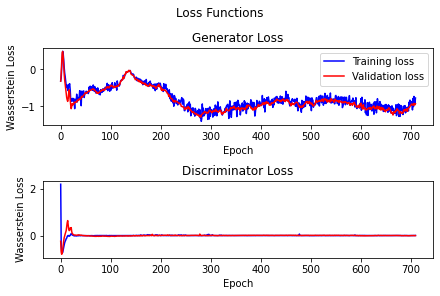

 36%|███▌      | 719/2000 [30:42<54:20,  2.55s/it]
Epoch 720:


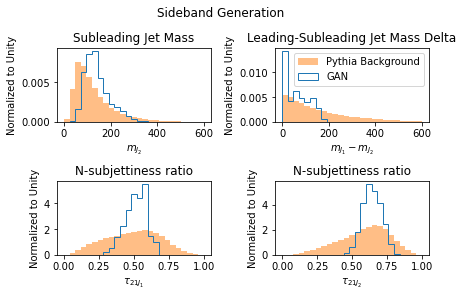

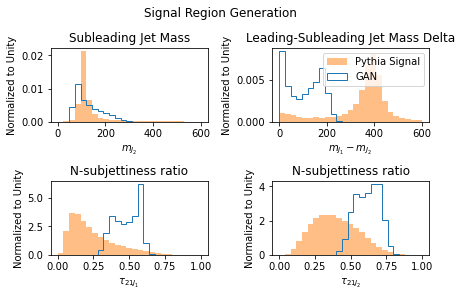

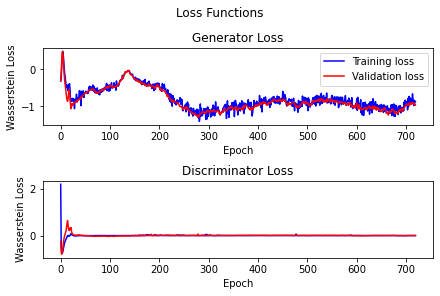

 36%|███▋      | 729/2000 [31:12<54:40,  2.58s/it]
Epoch 730:


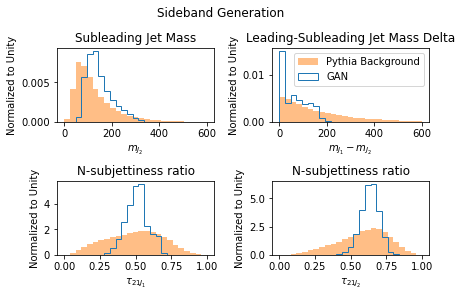

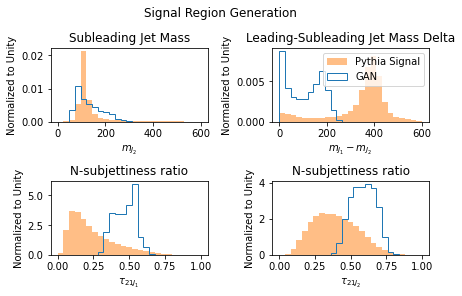

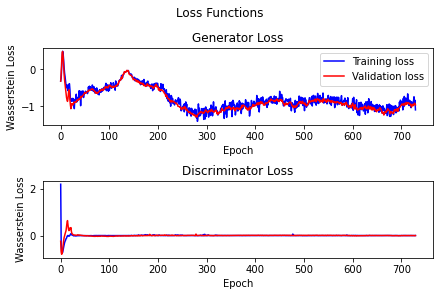

 37%|███▋      | 739/2000 [31:41<54:47,  2.61s/it]
Epoch 740:


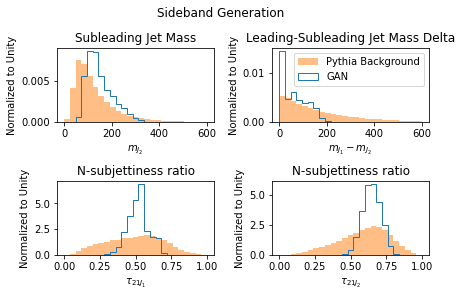

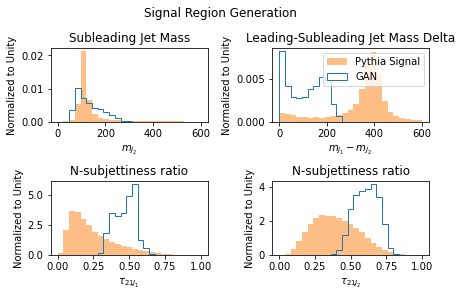

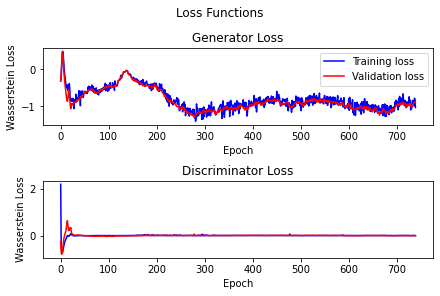

 37%|███▋      | 749/2000 [32:11<54:18,  2.60s/it]
Epoch 750:


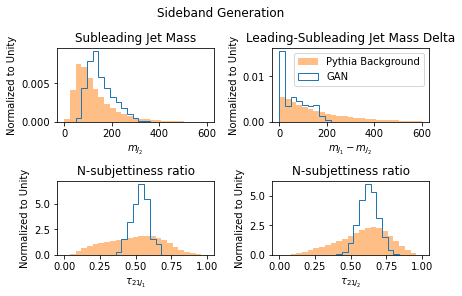

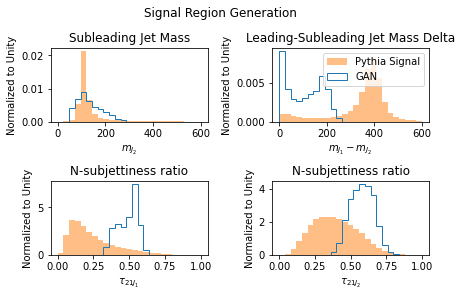

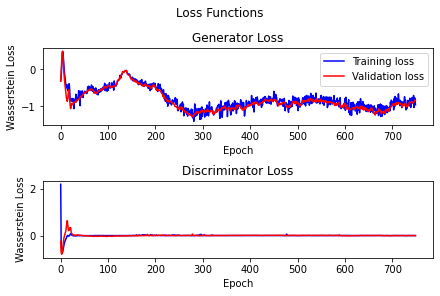

 38%|███▊      | 759/2000 [32:41<53:49,  2.60s/it]
Epoch 760:


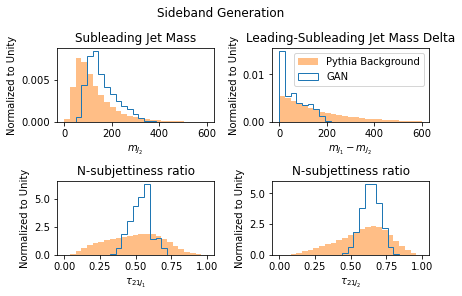

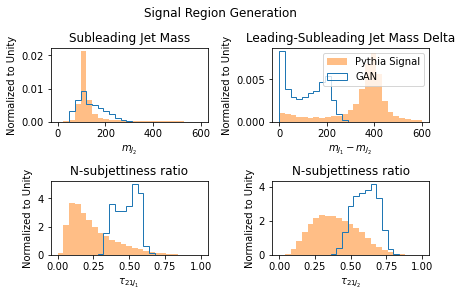

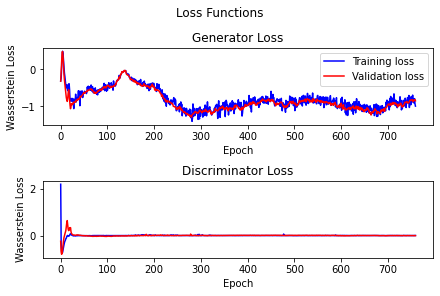

 38%|███▊      | 769/2000 [33:11<52:54,  2.58s/it]
Epoch 770:


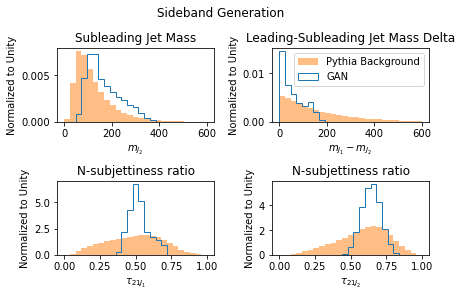

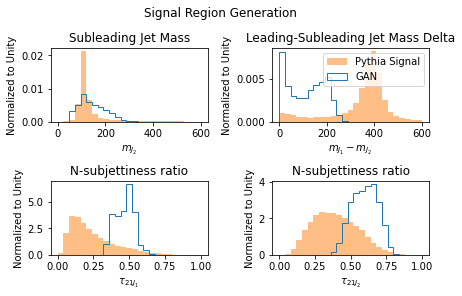

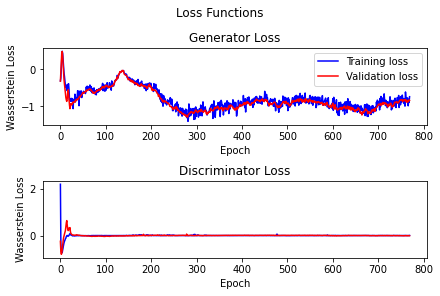

 39%|███▉      | 779/2000 [33:40<51:50,  2.55s/it]
Epoch 780:


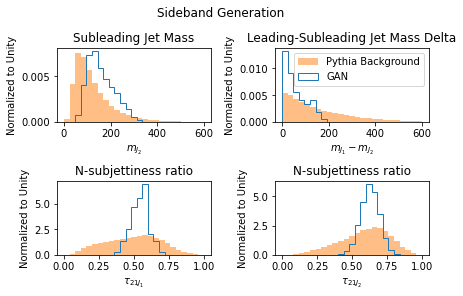

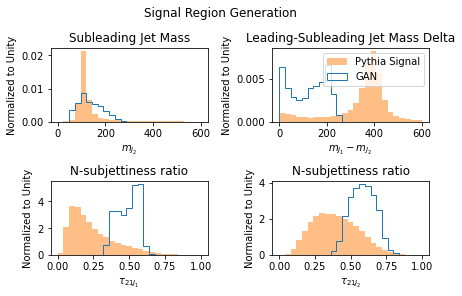

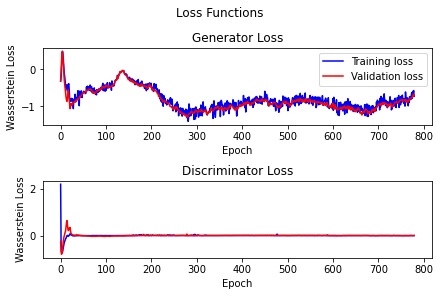

 39%|███▉      | 789/2000 [34:10<51:50,  2.57s/it]
Epoch 790:


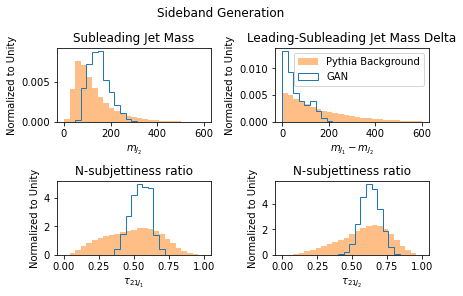

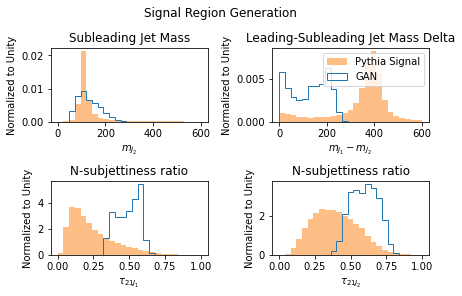

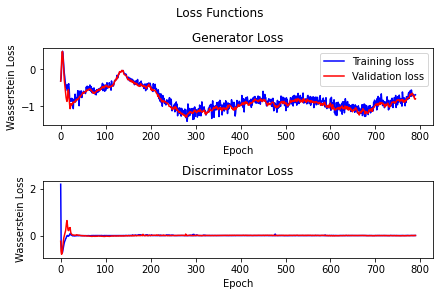

 40%|███▉      | 799/2000 [34:40<51:52,  2.59s/it]
Epoch 800:


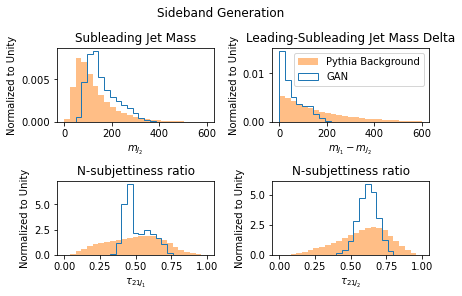

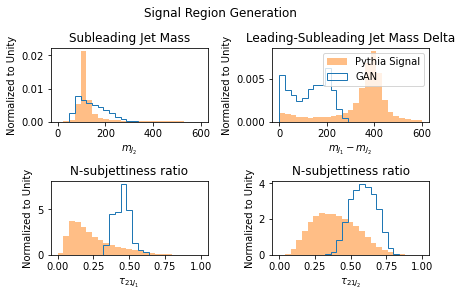

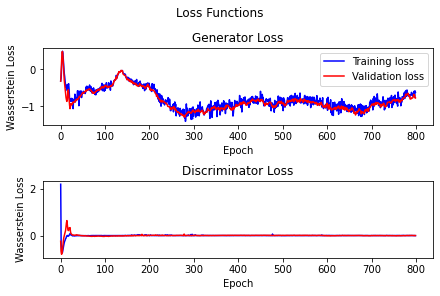

 40%|████      | 809/2000 [35:10<52:41,  2.65s/it]
Epoch 810:


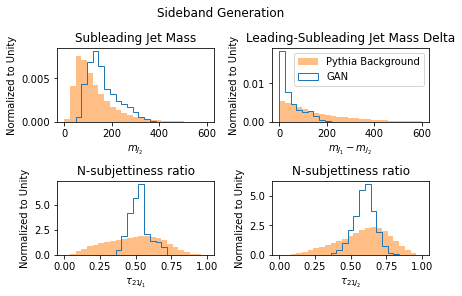

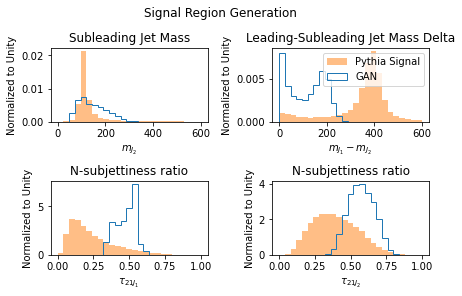

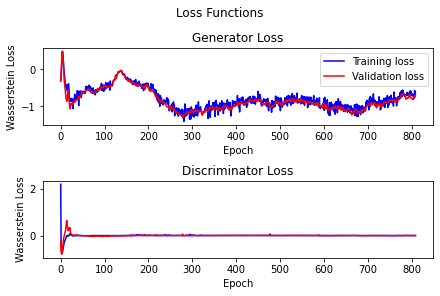

 41%|████      | 819/2000 [35:40<53:42,  2.73s/it]
Epoch 820:


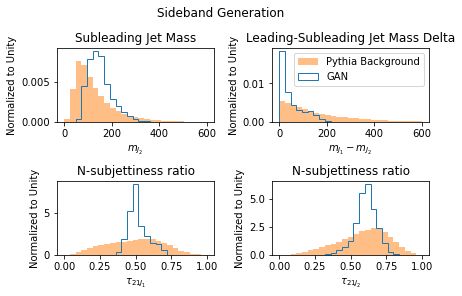

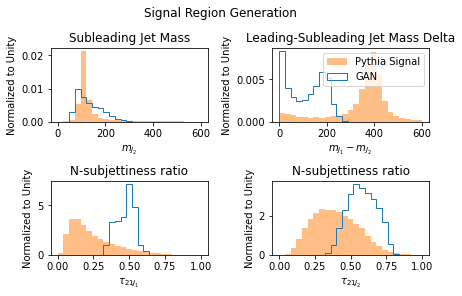

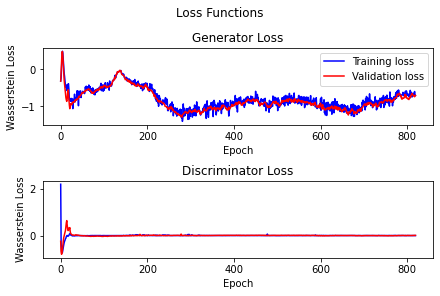

 41%|████▏     | 829/2000 [36:14<58:39,  3.01s/it]
Epoch 830:
 41%|████▏     | 829/2000 [36:18<51:17,  2.63s/it]


KeyboardInterrupt: 

In [28]:
train(train_dataset, test_dataset, EPOCHS, N_CRITIC)

## Results
???